In [46]:
import os, glob, re, pickle
from functools import partial
from collections import OrderedDict
import operator as op
from cytoolz import compose
import loompy as lp
import pandas as pd
import seaborn as sns
import numpy as np
import scanpy as sc
import anndata as ad
import matplotlib as mpl
import matplotlib.pyplot as plt
from adjustText import adjust_text
import cellrank as cr

from pyscenic.cli.utils import load_signatures

import loompy as lp
import json
import base64
import zlib
import re

from pyscenic.export import export2loom, add_scenic_metadata
from pyscenic.utils import load_motifs
from pyscenic.transform import df2regulons
from pyscenic.aucell import aucell
from pyscenic.binarization import binarize
from pyscenic.rss import regulon_specificity_scores
from pyscenic.plotting import plot_binarization, plot_rss

from IPython.display import HTML, display

In [100]:
BASE_URL = "https://plasmodb.org/a/images/pf_tfbs/"
COLUMN_NAME_LOGO = "MotifLogo"
COLUMN_NAME_MOTIF_ID = "MotifID"
COLUMN_NAME_TARGETS = "TargetGenes"

In [101]:
def display_logos(df: pd.DataFrame, top_target_genes: int = 3, base_url: str = BASE_URL):
    """
    :param df:
    :param base_url:
    """
    # Make sure the original dataframe is not altered.
    df = df.copy()
    
    # Add column with URLs to sequence logo.
    def create_url(motif_id):
        return '<img src="{}{}.png" style="max-height:124px;"></img>'.format(base_url, motif_id)
    df[("Enrichment", COLUMN_NAME_LOGO)] = list(map(create_url, df.index.get_level_values(COLUMN_NAME_MOTIF_ID)))
    
    # Truncate TargetGenes.
    def truncate(col_val):
        return sorted(col_val, key=op.itemgetter(1))[:top_target_genes]
    df[("Enrichment", COLUMN_NAME_TARGETS)] = list(map(truncate, df[("Enrichment", COLUMN_NAME_TARGETS)]))
    
    MAX_COL_WIDTH = pd.get_option('display.max_colwidth')
    pd.set_option('display.max_colwidth', -1)
    display(HTML(df.head().to_html(escape=False)))
    pd.set_option('display.max_colwidth', MAX_COL_WIDTH)

In [3]:
sc.settings.verbosity = 3 # verbosity: errors (0), warnings (1), info (2), hints (3)
#sc.logging.print_versions()
sc.settings.set_figure_params(dpi=200)

In [2]:
RESOURCES_FOLDERNAME = "./"

In [4]:
#
#CELL_ANNOTATIONS_FNAME = os.path.join(RESOURCES_FOLDERNAME, "cells_metadata.csv")
#ANNDATA_FNAME = os.path.join(RESOURCES_FOLDERNAME, 'for_shiny3d_v1.h5ad')
ANNDATA_FNAME = os.path.join(RESOURCES_FOLDERNAME, 'Sc_10x_gams_anndata_updated_raw_test.h5ad')
#ANNDATA_FNAME_out = os.path.join(RESOURCES_FOLDERNAME, 'scenic_out_020223.h5ad.h5ad')
#REGULONS_DAT_FNAME = os.path.join(RESOURCES_FOLDERNAME, 'regulons_v3.dat')
LOOM_FNAME = os.path.join(RESOURCES_FOLDERNAME, 'SCENIC-10X_auc_mtx_new_muba_v1.loom')
MOTIFS_FNAME = os.path.join(RESOURCES_FOLDERNAME, 'SCENIC-reg10x_new_muba_v1.csv')

In [7]:
REGULONS_DAT_FNAME = os.path.join(RESOURCES_FOLDERNAME, 'regulons_new_muba_v1.dat')

In [248]:
BIN_MTX_FNAME = os.path.join(RESOURCES_FOLDERNAME, 'new.bin.csv')
THR_FNAME = os.path.join(RESOURCES_FOLDERNAME, 'new.thresholds.csv')
LOOM_FNAME = os.path.join(RESOURCES_FOLDERNAME, 'SCENIC-10X_auc_mtx_new_forvis.loom')

In [164]:
LOOM_FNAME_out = os.path.join(RESOURCES_FOLDERNAME, 'SCENIC-10X_auc_mtx_new_forvis_mohammedetal_v1.loom')

In [365]:
LOOM_FNAME = os.path.join(RESOURCES_FOLDERNAME, 'SCENIC-10X_auc_mtx_new.loom')
#ad = sc.read_h5ad('for_shiny3d_SCENIC_out.h5ad')

In [54]:
ANNDATA_FNAME_out = os.path.join(RESOURCES_FOLDERNAME, 'for_shiny3d_SCENIC_out.h5ad')

In [52]:
#adata = sc.read_h5ad(ANNDATA_FNAME)
ad = sc.read_h5ad('scenic_out_for_vis_mohammedteal_muba_v1.h5ad')

In [107]:
df_motifs = load_motifs(MOTIFS_FNAME)
df_motifs

Enrichment                                  \
                                  AUC       NES MotifSimilarityQvalue   
TF            MotifID                                                   
PF3D7_1239200 PFL1900w_DLD   0.057230  3.422285                   NaN   
PF3D7_1139300 PF11_0404_D1   0.053389  3.080997                   NaN   
PF3D7_1107800 PF11_0091      0.085316  3.148709                   NaN   
PF3D7_1222400 PFL1075w       0.082672  3.038608                   NaN   
PF3D7_0420300 PFD0985w_D2    0.243966  3.169263                   NaN   
              PFD0985w_D2    0.076756  3.430462                   NaN   
              PFD0985w_D2    0.127202  3.163165                   NaN   
              PFD0985w_D2    0.192651  3.239169                   NaN   
PF3D7_1350900 PF13_0267      0.045155  3.892995                   NaN   
PF3D7_1139300 PF11_0404_D1   0.028472  3.198817                   NaN   
PF3D7_1408200 PF14_0079      0.030352  3.430157                   NaN   

                                                           \
                           OrthologousIdentity Annotation   
TF            MotifID                                       
PF3D7_1239200 PFL1900w_DLD                 NaN        NaN   
PF3D7_1139300 PF11_0404_D1                 NaN        NaN   
PF3D7_1107800 PF11_0091                    NaN        NaN   
PF3D7_1222400 PFL1075w                     NaN        NaN   
PF3D7_0420300 PFD0985w_D2                  NaN        NaN   
              PFD0985w_D2                  NaN        NaN   
              PFD0985w_D2                  NaN        NaN   
              PFD0985w_D2                  NaN        NaN   
PF3D7_1350900 PF13_0267                    NaN        NaN   
PF3D7_1139300 PF11_0404_D1                 NaN        NaN   
PF3D7_1408200 PF14_0079                    NaN        NaN   

                                                                               \
                                                                      Context   
TF            MotifID                                                           
PF3D7_1239200 PFL1900w_DLD  (weight>75.0%, activating, FALCIPARUM_v2.genes...   
PF3D7_1139300 PF11_0404_D1  (activating, FALCIPARUM_v2.genes_vs_motifs.ran...   
PF3D7_1107800 PF11_0091     (activating, FALCIPARUM_v2.genes_vs_motifs.ran...   
PF3D7_1222400 PFL1075w      (activating, FALCIPARUM_v2.genes_vs_motifs.ran...   
PF3D7_0420300 PFD0985w_D2   (activating, FALCIPARUM_v2.genes_vs_motifs.ran...   
              PFD0985w_D2   (activating, FALCIPARUM_v2.genes_vs_motifs.ran...   
              PFD0985w_D2   (activating, FALCIPARUM_v2.genes_vs_motifs.ran...   
              PFD0985w_D2   (activating, FALCIPARUM_v2.genes_vs_motifs.ran...   
PF3D7_1350900 PF13_0267     (repressing, FALCIPARUM_v2.genes_vs_motifs.ran...   
PF3D7_1139300 PF11_0404_D1  (repressing, FALCIPARUM_v2.genes_vs_motifs.ran...   
PF3D7_1408200 PF14_0079     (repressing, FALCIPARUM_v2.genes_vs_motifs.ran...   

                                                                               \
                                                                  TargetGenes   
TF            MotifID                                                           
PF3D7_1239200 PFL1900w_DLD  [(PF3D7_0727600, 5.044761043085787), (PF3D7_02...   
PF3D7_1139300 PF11_0404_D1  [(PF3D7_1473700, 10.093860501499394), (PF3D7_1...   
PF3D7_1107800 PF11_0091     [(PF3D7_0903700, 9.920549717781595), (PF3D7_02...   
PF3D7_1222400 PFL1075w      [(PF3D7_0903700, 9.920549717781595), (PF3D7_10...   
PF3D7_0420300 PFD0985w_D2   [(PF3D7_0314700, 62.144295014045184), (PF3D7_1...   
              PFD0985w_D2   [(PF3D7_0314700, 29.538307521815018), (PF3D7_1...   
              PFD0985w_D2   [(PF3D7_0314700, 18.081600218482038), (PF3D7_1...   
              PFD0985w_D2   [(PF3D7_0314700, 30.58025367157283), (PF3D7_12...   
PF3D7_1350900 PF13_0267                                [(PF3D7_0604100, 1.0)]   
PF3D7_1139300 PF11_0404_D1               [

In [108]:
display_logos(df_motifs)

/var/folders/1r/c51lkm653m76m013n3k4mz5c0000gn/T/ipykernel_7625/1961397235.py:20: FutureWarning: Passing a negative integer is deprecated in version 1.0 and will not be supported in future version. Instead, use None to not limit the column width.
  pd.set_option('display.max_colwidth', -1)


In [11]:
#display_logos(df_motifs_sel.sort_values([('Enrichment','NES')], ascending=False))

In [11]:
regulons_df = df2regulons(df_motifs)

Create regulons from a dataframe of enriched features.
Additional columns saved: []


In [12]:
# Pickle these regulons.
with open(REGULONS_DAT_FNAME, 'wb') as f:
    pickle.dump(regulons_df, f)

In [13]:
def fetch_logo(regulons_df, base_url = BASE_URL):
    for elem in regulons_df.context:
        if elem.endswith('.png'):
            return '<img src="{}{}" style="max-height:124px;"></img>'.format(base_url, elem)
    return ""

In [14]:
df_regulons = pd.DataFrame(data=[list(map(op.attrgetter('name'), regulons_df)),
                                 list(map(len, regulons_df)),
                                 list(map(fetch_logo, regulons_df))], index=['name', 'count', 'logo']).T

In [124]:
MAX_COL_WIDTH = pd.get_option('display.max_colwidth')
pd.set_option('display.max_colwidth', -1)
display(HTML(df_regulons.to_html(escape=False)))
pd.set_option('display.max_colwidth', MAX_COL_WIDTH)

/var/folders/1r/c51lkm653m76m013n3k4mz5c0000gn/T/ipykernel_7625/4105316667.py:2: FutureWarning: Passing a negative integer is deprecated in version 1.0 and will not be supported in future version. Instead, use None to not limit the column width.
  pd.set_option('display.max_colwidth', -1)


,name,count,logo
0,PF3D7_0420300(+),11,
1,PF3D7_1107800(+),2,
2,PF3D7_1139300(+),18,
3,PF3D7_1139300(-),1,
4,PF3D7_1222400(+),2,
5,PF3D7_1239200(+),2,
6,PF3D7_1350900(-),1,
7,PF3D7_1408200(-),2,


In [112]:
lf = lp.connect(LOOM_FNAME, mode='r', validate=False )
meta = json.loads(zlib.decompress(base64.b64decode( lf.attrs.MetaData )))
exprMat = pd.DataFrame( lf[:,:], index=lf.ra.Gene, columns=lf.ca.CellID).T
auc_mtx = pd.DataFrame( lf.ca.RegulonsAUC, index=lf.ca.CellID)

In [113]:
# create a dictionary of regulons:
regulons = {}
for i,r in pd.DataFrame(lf.ra.Regulons,index=lf.ra.Gene).iteritems():
    regulons[i] =  list(r[r==1].index.values)

/var/folders/1r/c51lkm653m76m013n3k4mz5c0000gn/T/ipykernel_7625/37080085.py:3: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for i,r in pd.DataFrame(lf.ra.Regulons,index=lf.ra.Gene).iteritems():


In [114]:
sig = load_signatures('SCENIC-reg10x_new_muba_v1.csv') 

Create regulons from a dataframe of enriched features.
Additional columns saved: []


In [390]:
#ad = add_scenic_metadata(adata, auc_mtx, sig)

In [125]:
ad_vis = add_scenic_metadata(adata, auc_mtx, regulons_df)

In [7]:
sc.pl.pca(ad_vis, color =['cell_class'])

NameError: name 'ad_vis' is not defined

In [120]:
sc.tl.umap(ad_vis, n_components= 3, spread=0.9, min_dist= 0.9)

computing UMAP


/Users/testi/miniconda3/envs/cellrank/lib/python3.8/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:09)


In [158]:
embedding_pca_tsne = pd.DataFrame(ad_vis.obsm['X_tsne'], columns=[['_X', '_Y']], index=ad_vis.obs_names)

In [159]:
ad_vis.write_h5ad('scenic_out_for_vis_mohammedteal_muba_v1.h5ad')

In [160]:
embedding_aucell_tsne = pd.DataFrame(ad_vis.obsm['X_tsne'], columns=[['_X', '_Y']], index=ad_vis.obs_names)

In [189]:
ad_vis

AnnData object with n_obs × n_vars = 4555 × 5019
    obs: 'n_genes', 'umi_counts', 'louvain_1.0', 'louvain_0.6', 'louvain_0.4', 'louvain_1.4', 'clusters', 'S_score', 'G2M_score', 'phase', 'male_signature', 'female_signature', 'cell_class', 'annotation', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'imcs_score', 'Bulk_labels', 'pruned_labels', 'first_labels', 'Regulon(PF3D7_0420300(+))', 'Regulon(PF3D7_1107800(+))', 'Regulon(PF3D7_1139300(+))', 'Regulon(PF3D7_1139300(-))', 'Regulon(PF3D7_1222400(+))', 'Regulon(PF3D7_1239200(+))', 'Regulon(PF3D7_1350900(-))', 'Regulon(PF3D7_1408200(-))'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'ribo', 'hb', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'Regulon(PF3D7_0420300 (+))', 'Regulon(PF3D7_1107800 (+))', 'Regulon(PF3D7_1139300 (+

In [131]:
selected_motifs = ['PF3D7_0420300','PF3D7_1107800','PF3D7_1139300']
df_motifs_sel = df_motifs.iloc[ [ True if x in selected_motifs else False for x in df_motifs.index.get_level_values('TF') ] ,:]

In [132]:
#display_logos(df_motifs.head())
display_logos( df_motifs_sel.sort_values([('Enrichment','NES')], ascending=False).head(20))

/var/folders/1r/c51lkm653m76m013n3k4mz5c0000gn/T/ipykernel_7625/1961397235.py:20: FutureWarning: Passing a negative integer is deprecated in version 1.0 and will not be supported in future version. Instead, use None to not limit the column width.
  pd.set_option('display.max_colwidth', -1)


In [133]:
cellAnnot = ad_vis.obs

In [134]:
rss_cellType = regulon_specificity_scores( auc_mtx, cellAnnot['cell_class'] )
rss_cellType

,PF3D7_0420300(+),PF3D7_1107800(+),PF3D7_1139300(+),PF3D7_1139300(-),PF3D7_1222400(+),PF3D7_1239200(+),PF3D7_1350900(-),PF3D7_1408200(-)
Early gametocyte,0.388556,0.254585,0.503360,0.171571,0.216347,0.269935,0.199771,0.172685
Male lineage,0.211859,0.179815,0.249614,0.167445,0.168597,0.217188,0.302084,0.167445
Female lineage,0.245935,0.278348,0.288163,0.224526,0.245809,0.282527,0.200294,0.231149


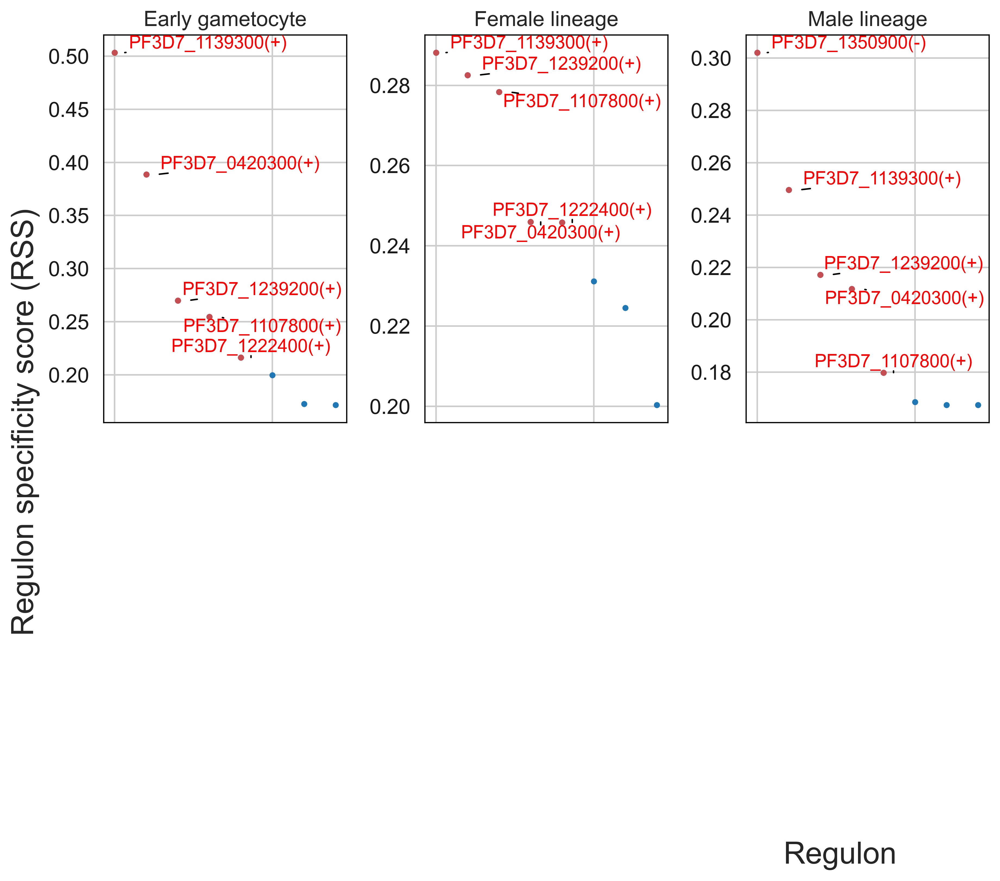

In [135]:
cats = sorted(list(set(cellAnnot['cell_class'])))

fig = plt.figure(figsize=(15, 8))
for c,num in zip(cats, range(1,len(cats)+1)):
    x=rss_cellType.T[c]
    ax = fig.add_subplot(2,5,num)
    plot_rss(rss_cellType, c, top_n=5, max_n=None, ax=ax)
    ax.set_ylim( x.min()-(x.max()-x.min())*0.05 , x.max()+(x.max()-x.min())*0.05 )
    for t in ax.texts:
        t.set_fontsize(12)
    ax.set_ylabel('')
    ax.set_xlabel('')
    adjust_text(ax.texts, autoalign='xy', ha='right', va='bottom', arrowprops=dict(arrowstyle='-',color='black'), precision=0.001 )
 
fig.text(0.5, 0.0, 'Regulon', ha='center', va='center', size='x-large')
fig.text(0.00, 0.5, 'Regulon specificity score (RSS)', ha='center', va='center', rotation='vertical', size='x-large')
plt.tight_layout()
plt.rcParams.update({
    'figure.autolayout': True,
        'figure.titlesize': 'large' ,
        'axes.labelsize': 'medium',
        'axes.titlesize':'large',
        'xtick.labelsize':'medium',
        'ytick.labelsize':'medium'
        })
plt.savefig("sc10x_gams_cellType-RSS-top5.pdf", dpi=600, bbox_inches = "tight")
plt.show()

In [136]:
topreg = []
for i,c in enumerate(cats):
    topreg.extend(
        list(rss_cellType.T[c].sort_values(ascending=False)[:5].index)
    )
topreg = list(set(topreg))
topreg

['PF3D7_0420300(+)',
 'PF3D7_1350900(-)',
 'PF3D7_1222400(+)',
 'PF3D7_1139300(+)',
 'PF3D7_1239200(+)',
 'PF3D7_1107800(+)']

In [41]:
#auc_mtx['cell_class'] = ad_vis.obs['cell_class']
#auc_mtx_unsorted = auc_mtx
#auc_mtx_unsorted['cell_class']=ad_vis.obs['cell_class']
#auc_mtx_unsorted.sort_values(by='cell_class', inplace=True)
#auc_mtx=auc_mtx_unsorted.drop('cell_class', axis=1)
#bin_mtx, thresholds = binarize(auc_mtx)

In [137]:
auc_mtx_Z = pd.DataFrame( index=auc_mtx.index )
for col in list(auc_mtx.columns):
    auc_mtx_Z[ col ] = ( auc_mtx[col] - auc_mtx[col].mean()) / auc_mtx[col].std(ddof=0)
#auc_mtx_Z.sort_index(inplace=True)

In [138]:
def palplot(pal, names, colors=None, size=1):
    n = len(pal)
    f, ax = plt.subplots(1, 1, figsize=(n * size, size))
    ax.imshow(np.arange(n).reshape(1, n),
              cmap=mpl.colors.ListedColormap(list(pal)),
              interpolation="nearest", aspect="auto")
    ax.set_xticks(np.arange(n) - .5)
    ax.set_yticks([-.5, .5])
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    colors = n * ['k'] if colors is None else colors
    for idx, (name, color) in enumerate(zip(names, colors)):
        ax.text(0.0+idx, 0.0, name, color=color, horizontalalignment='center', verticalalignment='center')
    return f

In [139]:
colors = sns.color_palette('bright',n_colors=len(cats) )
colorsd = dict( zip( cats, colors ))
colormap = [ colorsd[x] for x in cellAnnot['cell_class'] ]

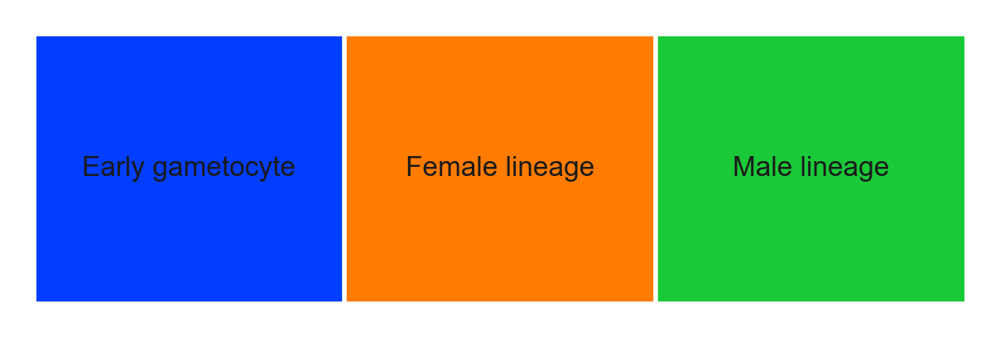

In [140]:
sns.set()
sns.set(font_scale=0.5)
fig = palplot( colors, cats, size=1.0)
#plt.savefig("PBMC10k_cellType-heatmap-legend-top5.pdf", dpi=600, bbox_inches = "tight")


In [141]:
sns.set(font_scale=1.2)
g = sns.clustermap(auc_mtx_Z[topreg].T, annot=False,  square=False,  linecolor='gray',
    yticklabels=False, xticklabels=True, vmin=-2, vmax=6, col_colors=colormap,
    cmap="YlGnBu", figsize=(21,16) )
g.cax.set_visible(True)
g.ax_heatmap.set_ylabel('')
g.ax_heatmap.set_xlabel('')
#plt.savefig("PBMC10k_cellType-heatmap-top5.pdf", dpi=600, bbox_inches = "tight")

/Users/testi/miniconda3/envs/cellrank/lib/python3.8/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


Text(0.5, -393.6611111111112, '')

In [471]:
#meta_sub = df_metadata[["Barcode", "Bulk_labels"]]
#meta_sub.set_index('annotation')
#meta_sub
#meta_sub.to_csv('metadata_scope.csv', index=False)

In [142]:
N_COLORS = len(ad_vis.obs.cell_class.dtype.categories)
#COLORS = [color['color'] for color in mpl.rcParams["axes.prop_cycle"]]
COLORS = ad_vis.uns['cell_class_colors']

In [143]:
color_class = dict(zip(ad_vis.obs.cell_class.dtype.categories, ad_vis.uns['cell_class_colors']))
color_clusters = dict(zip(ad_vis.obs.cell_class.dtype.categories, ad_vis.uns['clusters_colors']))

In [144]:
#df_metadata = ad.obs
#df_metadata.to_csv('cells_metadata.csv')
df_metadata = pd.read_csv('cells_metadata.csv')
df_metadata

,Barcode,n_genes,umi_counts,louvain_1.0,louvain_0.6,louvain_0.4,louvain_1.4,clusters,S_score,G2M_score,...,pruned_labels,first_labels,Regulon(PF3D7_0604100(-)),Regulon(PF3D7_0611200(+)),Regulon(PF3D7_0613800(+)),Regulon(PF3D7_1007700(-)),Regulon(PF3D7_1305200(+)),Regulon(PF3D7_1342900(+)),Regulon(PF3D7_1350900(+)),Regulon(PF3D7_1429200(+))
0,AAACCCAAGATGAATC-1,1340,2798.60820,0,0,0,7,0,-0.175439,-0.175439,...,II.Day5,II.Day5,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,AAACCCAGTGAATAAC-1,1524,2994.50590,5,5,5,11,5,0.047093,0.047093,...,IV.Day9,IV.Day9,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2,AAACCCAGTGAATTAG-1,1298,2745.15400,5,5,5,11,5,-0.022611,-0.022611,...,IV.Day9,IV.Day9,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
3,AAACCCATCCATCTAT-1,241,893.01843,8,1,1,10,8,-0.067437,-0.067437,...,IV.Day8,IV.Day8,0.000000,0.161355,0.000000,0.074369,0.000000,0.000000,0.000000,0.000000
4,AAACGAAAGGCGTCCT-1,1192,2590.70560,5,5,5,6,5,-0.199007,-0.199007,...,IV.Day9,II.III.Day6,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.290837,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4550,TTTGTTGGTAAGGCTG-1,1305,2757.71140,5,5,5,11,5,-0.119880,-0.119880,...,IV.Day9,II.III.Day6,0.800797,0.000000,0.000000,0.000000,0.486056,0.005662,0.000000,0.000000
4551,TTTGTTGGTCGGTGTC-1,808,2063.05400,0,0,0,2,0,-0.045277,-0.045277,...,II.III.Day6,II.III.Day6,0.000000,0.000000,0.000000,0.000000,0.000000,0.026001,0.321381,0.000000
4552,TTTGTTGGTCGTGGTC-1,686,1850.38290,6,3,3,5,6,-0.048457,-0.048457,...,II.III.Day6,II.Day5,0.000000,0.000000,0.062607,0.000000,0.000000,0.063116,0.000000,0.093227
4553,TTTGTTGGTGAGTTGG-1,1728,3202.45100,5,5,5,11,5,-0.009218,-0.009218,...,IV.Day9,IV.Day9,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


In [145]:
#cell_type_color_lut = dict(zip(adata.obs.cell_class.dtype.categories, COLORS))
cell_type_color_lut = dict(zip(ad_vis.obs.cell_class.dtype.categories, ad_vis.uns['cell_class_colors']))
cell_id2cell_type_lut = df_metadata.set_index('Barcode').cell_class.to_dict()
bw_palette = sns.xkcd_palette(["white", "black"])

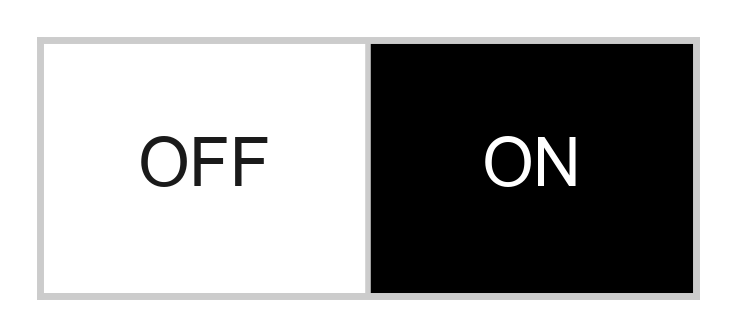

In [146]:
sns.set()
sns.set_style("whitegrid")
fig = palplot(bw_palette, ['OFF', 'ON'], ['k', 'w'])

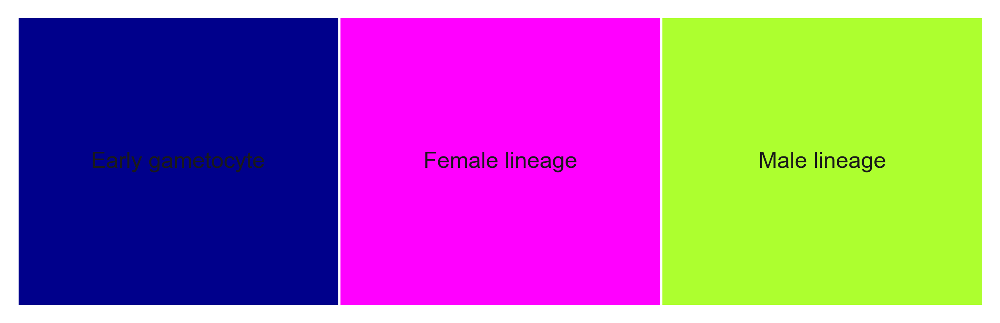

In [147]:
sns.set()
sns.set(font_scale=0.8)
fig = palplot(sns.color_palette(COLORS), ad_vis.obs.cell_class.dtype.categories, size=2)

/Users/testi/miniconda3/envs/cellrank/lib/python3.8/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


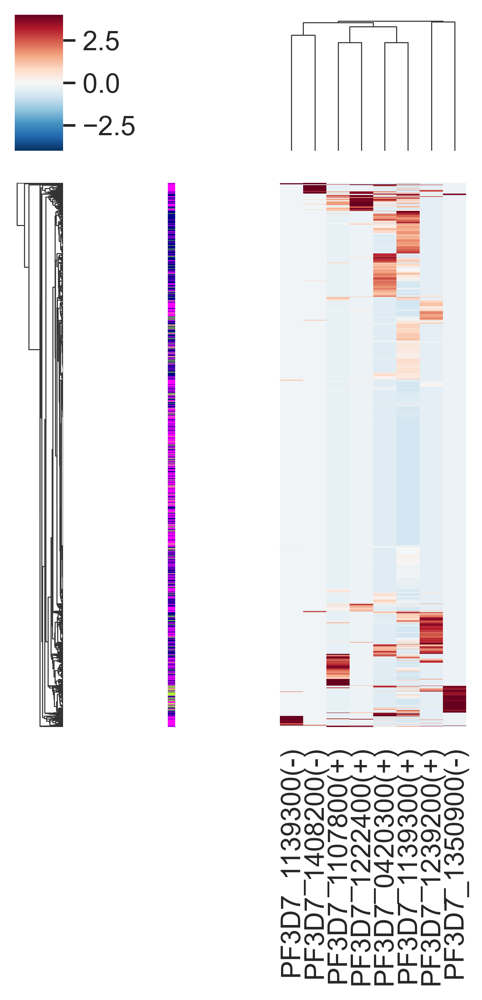

In [156]:
sns.set(font_scale=1.2)
g = sns.clustermap(auc_mtx_Z, annot=False,  square=False,  linecolor='gray',
    yticklabels=False, xticklabels=True, vmin=-4, vmax=4, row_colors=auc_mtx.index.map(cell_id2cell_type_lut).map(cell_type_color_lut),
    cmap="RdBu_r", figsize=(3.5,7) )
g.cax.set_visible(True)
g.ax_heatmap.set_ylabel('')
g.ax_heatmap.set_xlabel('')
plt.savefig("SC10xgams_cellType-heatmap-top8_muba_v1_20.02.23.png", dpi=800, bbox_inches = "tight")

In [42]:
binary_mtx, auc_thresholds = binarize( auc_mtx, num_workers=25 )
binary_mtx.head()

,PF3D7_0420300(+),PF3D7_1107800(+),PF3D7_1139300(+),PF3D7_1139300(-),PF3D7_1222400(+),PF3D7_1239200(+),PF3D7_1350900(-),PF3D7_1408200(-)
AAACCCAAGATGAATC-1,0,0,0,0,0,0,0,0
AAACCCAGTGAATAAC-1,0,0,0,0,0,0,0,0
AAACCCAGTGAATTAG-1,0,0,0,0,0,0,0,0
AAACCCATCCATCTAT-1,0,1,0,0,1,0,0,1
AAACGAAAGGCGTCCT-1,1,0,0,0,0,0,0,0


In [43]:
 r =  topreg
r

['PF3D7_0420300(+)',
 'PF3D7_1350900(-)',
 'PF3D7_1222400(+)',
 'PF3D7_1139300(+)',
 'PF3D7_1239200(+)',
 'PF3D7_1107800(+)']

/var/folders/1r/c51lkm653m76m013n3k4mz5c0000gn/T/ipykernel_7625/1440598345.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(auc_mtx[ r[i] ], ax=ax, norm_hist=True, bins=10)
/var/folders/1r/c51lkm653m76m013n3k4mz5c0000gn/T/ipykernel_7625/1440598345.py:7: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.di

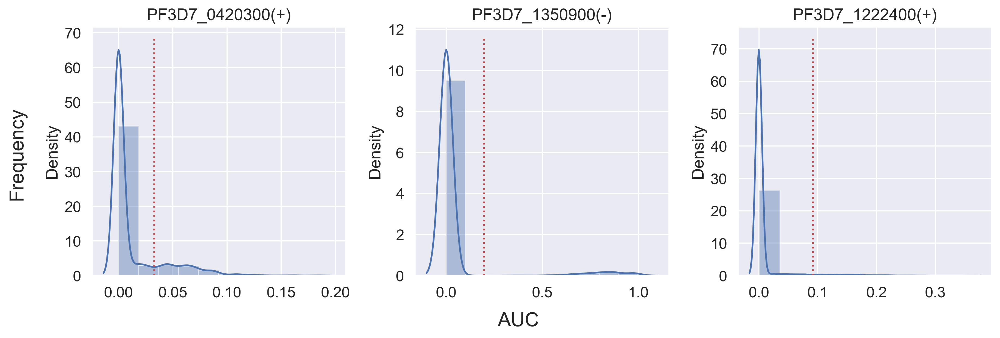

In [44]:
# select regulons:
r = [ 'PF3D7_0420300(+)', 'PF3D7_1350900(-)', 'PF3D7_1222400(+)', 'PF3D7_1139300(+)', 'PF3D7_1239200(+)' ]

    
fig, axs = plt.subplots(1, 3, figsize=(12, 4), dpi=150, sharey=False)
for i,ax in enumerate(axs):
    sns.distplot(auc_mtx[ r[i] ], ax=ax, norm_hist=True, bins=10)
    ax.plot( [ auc_thresholds[ r[i] ] ]*2, ax.get_ylim(), 'r:')
    ax.title.set_text( r[i] )
    ax.set_xlabel('')
    
fig.text(-0.01, 0.5, 'Frequency', ha='center', va='center', rotation='vertical', size='large')
fig.text(0.5, -0.01, 'AUC', ha='center', va='center', rotation='horizontal', size='large')

fig.tight_layout()
#fig.savefig('PBMC10k_cellType-binaryPlot2_muba.pdf', dpi=600, bbox_inches='tight')
#fig.savefig('PBMC10k_cellType-binaryPlot2.pdf', dpi=600, bbox_inches='tight')ype-binaryPlot2.pdf', dpi=600, bbox_inches='tight')

In [45]:
rss_louvain = regulon_specificity_scores( auc_mtx, cellAnnot['annotation'] )
rss_louvain

,PF3D7_0420300(+),PF3D7_1107800(+),PF3D7_1139300(+),PF3D7_1139300(-),PF3D7_1222400(+),PF3D7_1239200(+),PF3D7_1350900(-),PF3D7_1408200(-)
C0,0.266373,0.238118,0.303983,0.168266,0.181165,0.245100,0.180879,0.168052
C5,0.205927,0.175915,0.240589,0.167445,0.168686,0.213980,0.297661,0.167445
C8,0.173474,0.180915,0.179181,0.377941,0.185567,0.211975,0.167445,0.347437
C2,0.206754,0.229357,0.223665,0.167445,0.171529,0.234167,0.187738,0.167445
C3,0.306394,0.267658,0.308515,0.181352,0.365790,0.200957,0.182531,0.236850
C6,0.257283,0.193051,0.288998,0.181185,0.187805,0.194625,0.227412,0.194851
C4,0.307382,0.192126,0.347412,0.170882,0.190466,0.212695,0.179269,0.172619
C7,0.174372,0.204730,0.187888,0.189503,0.190663,0.210246,0.190180,0.167727
C9,0.212535,0.183585,0.232318,0.167445,0.183797,0.209591,0.187659,0.167445
C1,0.174912,0.224600,0.188940,0.192715,0.189373,0.239968,0.190826,0.175234


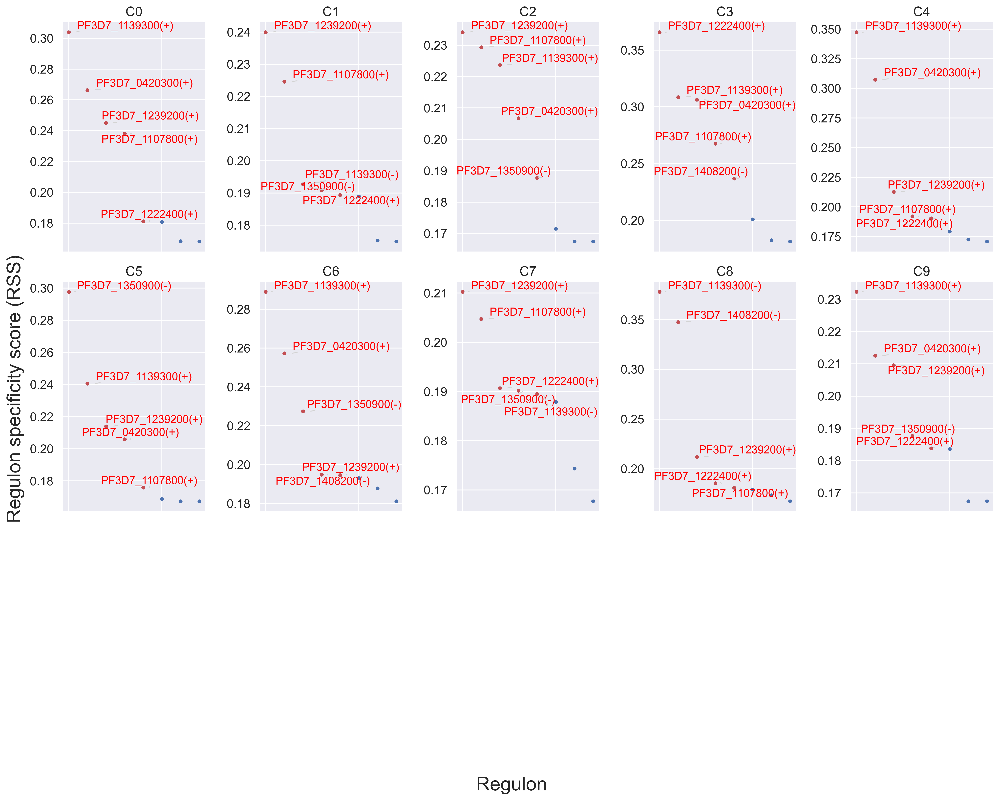

In [46]:
cats = sorted( list(set(cellAnnot['annotation'])) )

fig = plt.figure(figsize=(15, 12))
for c,num in zip(cats, range(1,len(cats)+1)):
    x=rss_louvain.T[c]
    ax = fig.add_subplot(3,5,num)
    plot_rss(rss_louvain, c, top_n=5, max_n=None, ax=ax)
    ax.set_ylim( x.min()-(x.max()-x.min())*0.05 , x.max()+(x.max()-x.min())*0.05 )
    for t in ax.texts:
        t.set_fontsize(12)
    ax.set_ylabel('')
    ax.set_xlabel('')
    adjust_text(ax.texts, autoalign='xy', ha='right', va='bottom', arrowprops=dict(arrowstyle='-',color='lightgrey'), precision=0.001 )
 
fig.text(0.5, 0.0, 'Regulon', ha='center', va='center', size='x-large')
fig.text(0.00, 0.5, 'Regulon specificity score (RSS)', ha='center', va='center', rotation='vertical', size='x-large')
plt.tight_layout()
plt.rcParams.update({
    'figure.autolayout': True,
        'figure.titlesize': 'large' ,
        'axes.labelsize': 'medium',
        'axes.titlesize':'large',
        'xtick.labelsize':'medium',
        'ytick.labelsize':'medium'
        })
#plt.savefig("PBMC10k_Louvain-RSS-top5.png", dpi=150, bbox_inches = "tight")
plt.show()

In [47]:
topreg = []
for i,c in enumerate(cats):
    topreg.extend(
        list(rss_louvain.T[c].sort_values(ascending=False)[:5].index)
    )
topreg = list(set(topreg))
topreg

['PF3D7_0420300(+)',
 'PF3D7_1350900(-)',
 'PF3D7_1222400(+)',
 'PF3D7_1139300(+)',
 'PF3D7_1239200(+)',
 'PF3D7_1139300(-)',
 'PF3D7_1107800(+)',
 'PF3D7_1408200(-)']

In [48]:
def palplot(pal, names, colors=None, size=1):
    n = len(pal)
    f, ax = plt.subplots(1, 1, figsize=(n * size, size))
    ax.imshow(np.arange(n).reshape(1, n),
              cmap=mpl.colors.ListedColormap(list(pal)),
              interpolation="nearest", aspect="auto")
    ax.set_xticks(np.arange(n) - .5)
    ax.set_yticks([-.5, .5])
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    colors = n * ['k'] if colors is None else colors
    for idx, (name, color) in enumerate(zip(names, colors)):
        ax.text(0.0+idx, 0.0, name, color=color, horizontalalignment='center', verticalalignment='center')
    return f

In [49]:
colors = sns.color_palette('bright',n_colors=len(cats) )
colorsd = dict( zip( cats, colors ))
colormap = [ colorsd[x] for x in cellAnnot['annotation'] ]

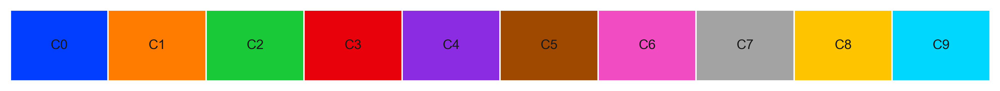

In [50]:
sns.set()
sns.set(font_scale=0.8)
fig = palplot( colors, cats, size=1.0)

In [51]:
sns.set(font_scale=1.2)
g = sns.clustermap(auc_mtx_Z[topreg], annot=False,  square=False,  linecolor='gray',
    yticklabels=False, vmin=-2, vmax=6, row_colors=colormap,
    cmap="YlGnBu", figsize=(21,16) )
g.cax.set_visible(True)
g.ax_heatmap.set_ylabel('')    
g.ax_heatmap.set_xlabel('')  

/Users/testi/miniconda3/envs/cellrank/lib/python3.8/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


Text(0.5, 32.08888888888842, '')

In [52]:
bin_mtx, thresholds = binarize(auc_mtx)
bin_mtx.to_csv('./new.bin_muba_v1.csv')
thresholds.to_frame().rename(columns={0:'threshold'}).to_csv('./new.thr_muba_v1.csv')

In [163]:
DATASET_ID = "mohammedetalxxx"
TCGA_CODE = 'xxx'

In [162]:
regulons_df = [r.rename(r.name.replace('(',' (')) for r in regulons_df]

regulons_df

[Regulon(name='PF3D7_0420300  (+)', gene2weight=frozendict.frozendict({'PF3D7_0314700': 62.144295014045184, 'PF3D7_1355700': 57.90951232877353, 'PF3D7_1236200': 95.31302986842236, 'PF3D7_0420300': 52.756147895282645, 'PF3D7_1420700': 62.58594333631308, 'PF3D7_1474000': 86.77319944968579, 'PF3D7_1138400': 54.9204428835224, 'PF3D7_1121600': 16.576793751879148, 'PF3D7_0810800': 25.166512318511646, 'PF3D7_1444100': 30.58940159880167, 'PF3D7_1429200': 1.0}), gene2occurrence=frozendict.frozendict({}), transcription_factor='PF3D7_0420300', context=frozenset({'activating', 'PFD0985w_D2.png'}), score=3.4304617424532458, nes=0.0, orthologous_identity=0.0, similarity_qvalue=0.0, annotation=''),
 Regulon(name='PF3D7_1107800  (+)', gene2weight=frozendict.frozendict({'PF3D7_0903700': 9.920549717781595, 'PF3D7_0204900': 9.81656369550956}), gene2occurrence=frozendict.frozendict({}), transcription_factor='PF3D7_1107800', context=frozenset({'activating', 'PF11_0091.png'}), score=3.1487089366325667, nes=

In [165]:
export2loom(ad_vis.to_df(), regulons_df, LOOM_FNAME_out,
            cell_annotations=ad_vis.obs['annotation'].to_dict(),
            embeddings=OrderedDict([('AUCell + tSNE', embedding_aucell_tsne), ('PCA + tSNE', embedding_pca_tsne)]),
            auc_mtx = auc_mtx,
            tree_structure=(),
            title='mohammedetal_dataset'.format(TCGA_CODE, DATASET_ID),
            nomenclature="PF3D7", auc_thresholds=thresholds,
            compress=True)

/Users/testi/miniconda3/envs/cellrank/lib/python3.8/site-packages/pyscenic/export.py:189: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.
  for name, threshold in auc_thresholds.iteritems()


In [57]:
ad_vis

AnnData object with n_obs × n_vars = 4555 × 5019
    obs: 'n_genes', 'umi_counts', 'louvain_1.0', 'louvain_0.6', 'louvain_0.4', 'louvain_1.4', 'clusters', 'S_score', 'G2M_score', 'phase', 'male_signature', 'female_signature', 'cell_class', 'annotation', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'imcs_score', 'Bulk_labels', 'pruned_labels', 'first_labels', 'Regulon(PF3D7_0420300(+))', 'Regulon(PF3D7_1107800(+))', 'Regulon(PF3D7_1139300(+))', 'Regulon(PF3D7_1139300(-))', 'Regulon(PF3D7_1222400(+))', 'Regulon(PF3D7_1239200(+))', 'Regulon(PF3D7_1350900(-))', 'Regulon(PF3D7_1408200(-))'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'ribo', 'hb', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'Regulon(PF3D7_0420300(+))', 'Regulon(PF3D7_1107800(+))', 'Regulon(PF3D7_1139300(+))'

/Users/testi/miniconda3/envs/cellrank/lib/python3.8/site-packages/scanpy/plotting/_utils.py:288: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  pl.savefig(filename, dpi=dpi, bbox_inches='tight')
/Users/testi/miniconda3/envs/cellrank/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.canvas.print_figure(bytes_io, **kw)


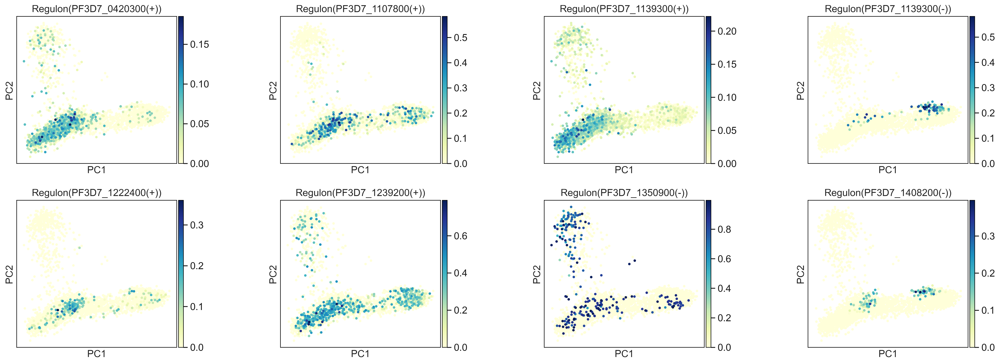

In [66]:
regs = ["Regulon(PF3D7_0420300(+))", "Regulon(PF3D7_1107800(+))","Regulon(PF3D7_1139300(+))", "Regulon(PF3D7_1139300(-))", "Regulon(PF3D7_1222400(+))",
       "Regulon(PF3D7_1239200(+))", "Regulon(PF3D7_1350900(-))", "Regulon(PF3D7_1408200(-))"]
sc.pl.pca(ad_vis,color=regs, cmap='YlGnBu', size = 50, wspace=0.5, save='regs_umap.png') 

In [59]:
regs

['cell_class',
 'Regulon(PF3D7_0420300(+))',
 'Regulon(PF3D7_1107800(+))',
 'Regulon(PF3D7_1139300(+))',
 'Regulon(PF3D7_1139300(-))',
 'Regulon(PF3D7_1222400(+))',
 'Regulon(PF3D7_1239200(+))',
 'Regulon(PF3D7_1350900(-))',
 'Regulon(PF3D7_1408200(-))']

/Users/testi/miniconda3/envs/cellrank/lib/python3.8/site-packages/scanpy/plotting/_utils.py:288: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  pl.savefig(filename, dpi=dpi, bbox_inches='tight')
/Users/testi/miniconda3/envs/cellrank/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.canvas.print_figure(bytes_io, **kw)


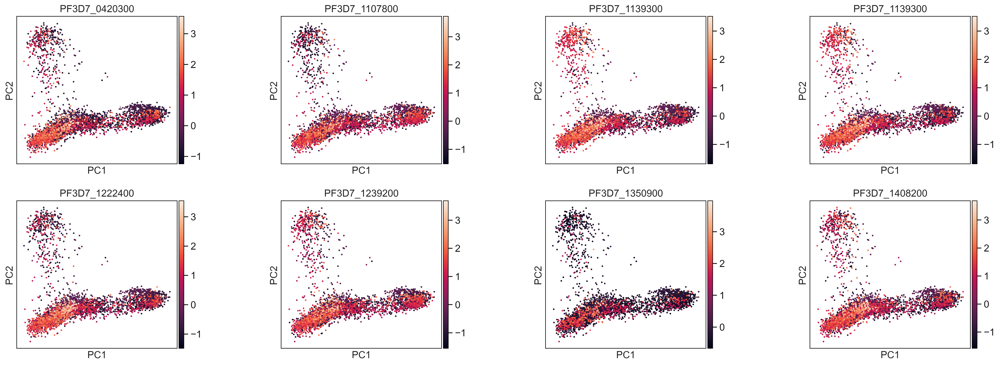

In [65]:
TFS = ['PF3D7_0420300', 'PF3D7_1107800', 'PF3D7_1139300', 'PF3D7_1139300', 'PF3D7_1222400', 'PF3D7_1239200', 'PF3D7_1350900', 'PF3D7_1408200']
sc.pl.pca(ad_vis, color = TFS, size = 20, wspace=0.5, use_raw=False, save='TFs_pca.png') #save='TFs_pca.png'


/Users/testi/miniconda3/envs/cellrank/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


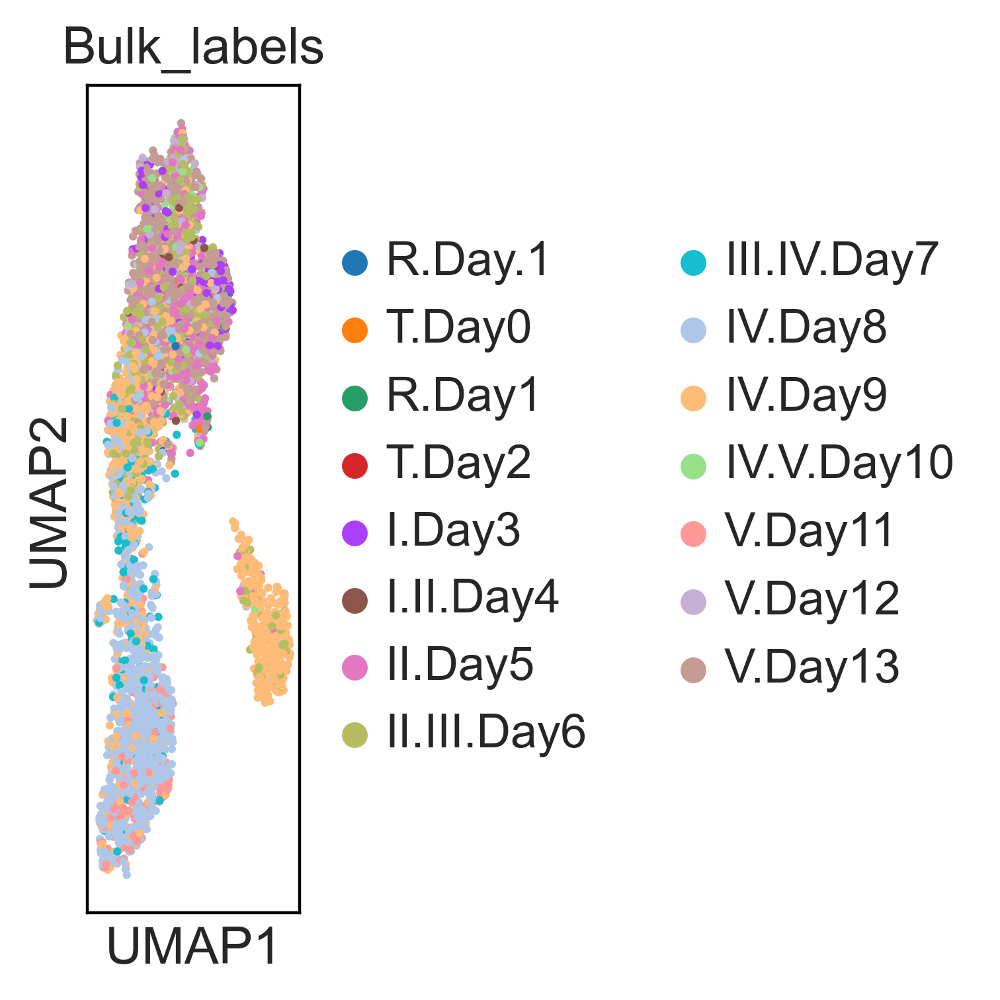

In [184]:
TFS = ['PF3D7_0420300', 'PF3D7_1107800', 'PF3D7_1139300', 'PF3D7_1139300', 'PF3D7_1222400', 'PF3D7_1239200', 'PF3D7_1350900', 'PF3D7_1408200']
sc.pl.umap(ad_vis, color = ['Bulk_labels'], size = 20, wspace=0.5, use_raw=False) #save='TFs_pca.png'



In [35]:
kwargs = dict(frameon=True, size=150, linewidth=1.5)

/Users/testi/miniconda3/envs/cellrank/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  cax = scatter(


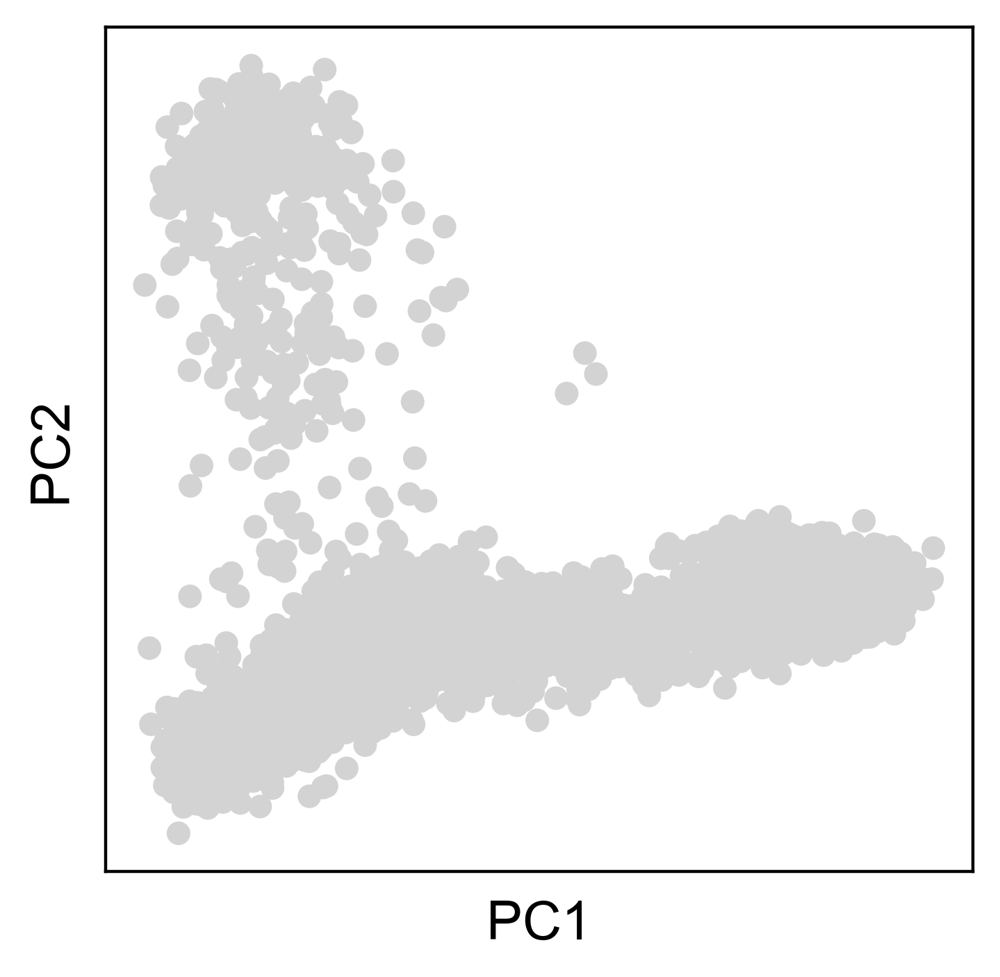

In [56]:
sc.pl.pca(ad, **kwargs)

In [ ]:
df_obs = ad.obs
signature_column_names = list(df_obs.select_dtypes('number').columns)
signature_column_names = list(filter(lambda s: s.startswith('Regulon('), signature_column_names))
df_scores = df_obs[signature_column_names + ['cell_class']]
df_results = ((df_scores.groupby(by='cell_class').mean() - df_obs[signature_column_names].mean())/ df_obs[signature_column_names].std()).stack().reset_index().rename(columns={'level_1': 'regulon', 0:'Z'})
df_results['regulon'] = list(map(lambda s: s[8:-1], df_results.regulon))
df_results[(df_results.Z >= 3.0)].sort_values('Z', ascending=False).head()

In [14]:
auc_mtx.head()

,PF3D7_0604100(-),PF3D7_0611200(+),PF3D7_0613800(+),PF3D7_1007700(-),PF3D7_1305200(+),PF3D7_1342900(+),PF3D7_1350900(+),PF3D7_1429200(+)
AAACCCAAGATGAATC-1,0.0,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0
AAACCCAGTGAATAAC-1,0.0,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0
AAACCCAGTGAATTAG-1,0.0,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0
AAACCCATCCATCTAT-1,0.0,0.161355,0.0,0.074369,0.0,0.0,0.000000,0.0
AAACGAAAGGCGTCCT-1,0.0,0.000000,0.0,0.000000,0.0,0.0,0.290837,0.0


In [15]:
lf.close()

In [16]:
adata = sc.read_h5ad(ANNDATA_FNAME) # read the anndata h5ad 

In [24]:
#Dont run if you used prepared object
old_to_new = {
'0':'C0',
'1':'C1',
'2':'C2',
'3':'C3',
'4':'C4',
'5':'C5',
'6':'C6',
'7':'C7',
'8':'C8',
'9':'C9',
}
adata.obs['annotation'] = (
adata.obs['clusters']
.map(old_to_new)
.astype('category')
)

In [25]:
#adata = adata[adata.obs['cell_class'].isin(['Differentiated female', 'Differentiated male', 'Early gametocyte', 'Mature female'])]
#adata.obs['cell_class'].cat.reorder_categories(['Early gametocyte', 'Differentiated female', 'Mature female', 'Differentiated male'], inplace = True)

/Users/mohammedmubasher/opt/anaconda3/envs/cellrank/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2630: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
/Users/mohammedmubasher/opt/anaconda3/envs/cellrank/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2630: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  res = method(*args, **kwargs)


/Users/testi/miniconda3/envs/cellrank/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/testi/miniconda3/envs/cellrank/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/testi/miniconda3/envs/cellrank/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/testi/miniconda3/envs/cellrank/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.canvas.print_figure(bytes_io, **kw)


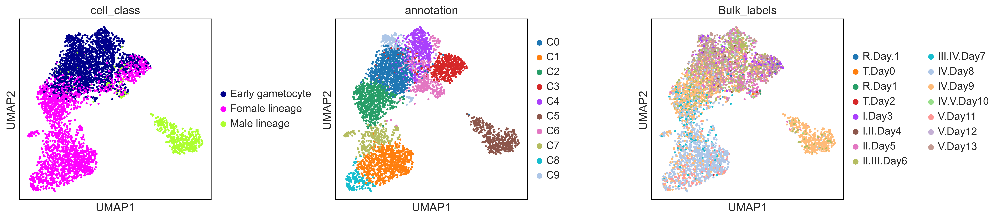

In [79]:
sc.pl.umap(ad_vis, color =['cell_class', 'annotation', 'Bulk_labels'], wspace =0.5)

In [243]:
bin_mtx['cell_class'] = adata.obs['cell_class']
#bin_mtx['clusters'] = adata.obs['clusters']

In [244]:
auc_mtx

,PF3D7_0604100(-),PF3D7_0611200(+),PF3D7_0613800(+),PF3D7_1007700(-),PF3D7_1305200(+),PF3D7_1342900(+),PF3D7_1350900(+),PF3D7_1429200(+)
AAACCCAAGATGAATC-1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
AAACCCAGTGAATAAC-1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
AAACCCAGTGAATTAG-1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
AAACCCATCCATCTAT-1,0.000000,0.161355,0.000000,0.074369,0.000000,0.000000,0.000000,0.000000
AAACGAAAGGCGTCCT-1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.290837,0.000000
...,...,...,...,...,...,...,...,...
TTTGTTGGTAAGGCTG-1,0.800797,0.000000,0.000000,0.000000,0.486056,0.005662,0.000000,0.000000
TTTGTTGGTCGGTGTC-1,0.000000,0.000000,0.000000,0.000000,0.000000,0.026001,0.321381,0.000000
TTTGTTGGTCGTGGTC-1,0.000000,0.000000,0.062607,0.000000,0.000000,0.063116,0.000000,0.093227
TTTGTTGGTGAGTTGG-1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000


/Users/mubashermohammed/miniconda3/envs/cellrank/lib/python3.8/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


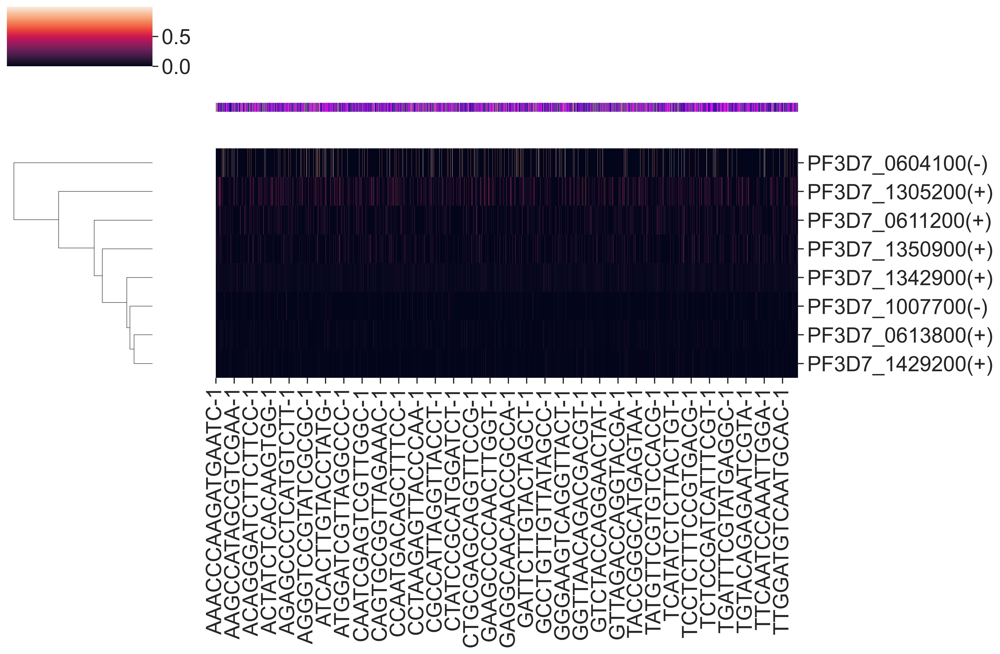

In [245]:
sns.clustermap(auc_mtx.T,col_cluster=False, row_cluster=True,
               col_colors=auc_mtx.index.map(cell_id2cell_type_lut).map(cell_type_color_lut),
                figsize=(15,10))
g.ax_heatmap.set_xticklabels([])
g.ax_heatmap.set_xticks([])
g.ax_heatmap.set_xlabel('Cells')
g.ax_heatmap.set_ylabel('Regulons')
g.ax_col_colors.set_yticks([0.5])
g.ax_col_colors.set_yticklabels(['Cell Class'])
g.cax.set_visible(False)

In [246]:
auc_mtx['cell_class'] = adata.obs['cell_class']


In [25]:
#bin_mtx.to_csv('bin_metadata.csv')

In [247]:
#get the thershold and the bin
auc_mtx_unsorted = auc_mtx
auc_mtx_unsorted['cell_class']=adata.obs['cell_class']
auc_mtx_unsorted.sort_values(by='cell_class', inplace=True)
auc_mtx=auc_mtx_unsorted.drop('cell_class', axis=1)
bin_mtx, thresholds = binarize(auc_mtx)

In [96]:
#bin_mtx, thresholds = binarize(auc_mtx)

In [24]:
bin_mtx.to_csv('bin_mtx.csv') # save things
thresholds.to_frame().rename(columns={0:'threshold'}).to_csv('thr_mtx.csv')
#thresholds

In [262]:
bin_mtx = pd.read_csv('./data_new/bin_mtx.csv', index_col=0)
thresholds = pd.read_csv('./data_new/thr_mtx.csv', index_col=0).threshold

/Users/mubashermohammed/miniconda3/envs/cellrank/lib/python3.8/site-packages/pyscenic/plotting.py:22: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(auc_mtx[regulon_name], ax=ax, norm_hist=True, bins=bins)
/Users/mubashermohammed/miniconda3/envs/cellrank/lib/python3.8/site-packages/pyscenic/plotting.py:22: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/

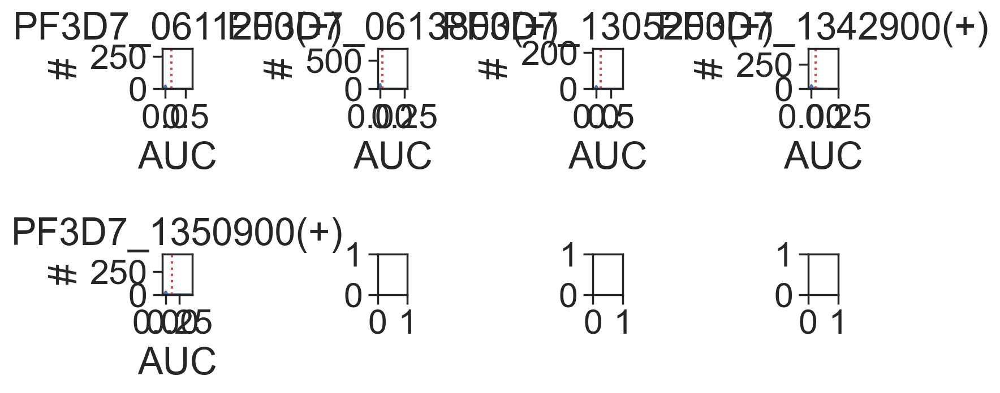

In [263]:
fig, ((ax1, ax2, ax3, ax4), (ax5, ax6, ax7, ax8)) = plt.subplots(2, 4, figsize=(8, 4), dpi=100)

plot_binarization(auc_mtx, 'PF3D7_0611200(+)', thresholds['PF3D7_0611200(+)'],ax=ax1)
plot_binarization(auc_mtx, 'PF3D7_0613800(+)', thresholds['PF3D7_0613800(+)'],ax=ax2)
plot_binarization(auc_mtx, 'PF3D7_1305200(+)', thresholds['PF3D7_1305200(+)'],ax=ax3)
plot_binarization(auc_mtx, 'PF3D7_1342900(+)', thresholds['PF3D7_1342900(+)'],ax=ax4)
plot_binarization(auc_mtx, 'PF3D7_1350900(+)', thresholds['PF3D7_1350900(+)'],ax=ax5)
plt.tight_layout() ## need some fixation could be unsorted auc_mtx

In [264]:
def palplot(pal, names, colors=None, size=1):
    n = len(pal)
    f, ax = plt.subplots(1, 1, figsize=(n * size, size))
    ax.imshow(np.arange(n).reshape(1, n),
              cmap=mpl.colors.ListedColormap(list(pal)),
              interpolation="nearest", aspect="auto")
    ax.set_xticks(np.arange(n) - .5)
    ax.set_yticks([-.5, .5])
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    colors = n * ['k'] if colors is None else colors
    for idx, (name, color) in enumerate(zip(names, colors)):
        ax.text(0.0+idx, 0.0, name, color=color, horizontalalignment='center', verticalalignment='center')
    return f

In [265]:
auc_mtx

,PF3D7_0604100(-),PF3D7_0611200(+),PF3D7_0613800(+),PF3D7_1007700(-),PF3D7_1305200(+),PF3D7_1342900(+),PF3D7_1350900(+),PF3D7_1429200(+)
AAACCCAAGATGAATC-1,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.0
GATTGGTGTTGAAGTA-1,0.000000,0.000000,0.000000,0.0,0.000000,0.051373,0.000000,0.0
GATTGGTTCGTGGGTC-1,0.000000,0.125498,0.000000,0.0,0.000000,0.014049,0.000000,0.0
GATTTCTAGATCGACG-1,0.000000,0.000000,0.014229,0.0,0.000000,0.031243,0.000000,0.0
GCAACATAGTGGAAAG-1,0.000000,0.000000,0.000000,0.0,0.000000,0.049277,0.000000,0.0
...,...,...,...,...,...,...,...,...
CGGAACCCACTGCGAC-1,0.000000,0.000000,0.000000,0.0,0.278884,0.018033,0.000000,0.0
TCGGGACCAATTGCGT-1,0.741036,0.282869,0.000000,0.0,0.000000,0.017823,0.000000,0.0
TCGGGACGTCGAGCAA-1,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.0
TCGGGCACACGACAAG-1,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.0


In [266]:
N_COLORS = len(adata.obs.cell_class.dtype.categories)
#COLORS = [color['color'] for color in mpl.rcParams["axes.prop_cycle"]]
COLORS = adata.uns['cell_class_colors']

/Users/testi/miniconda3/envs/cellrank/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


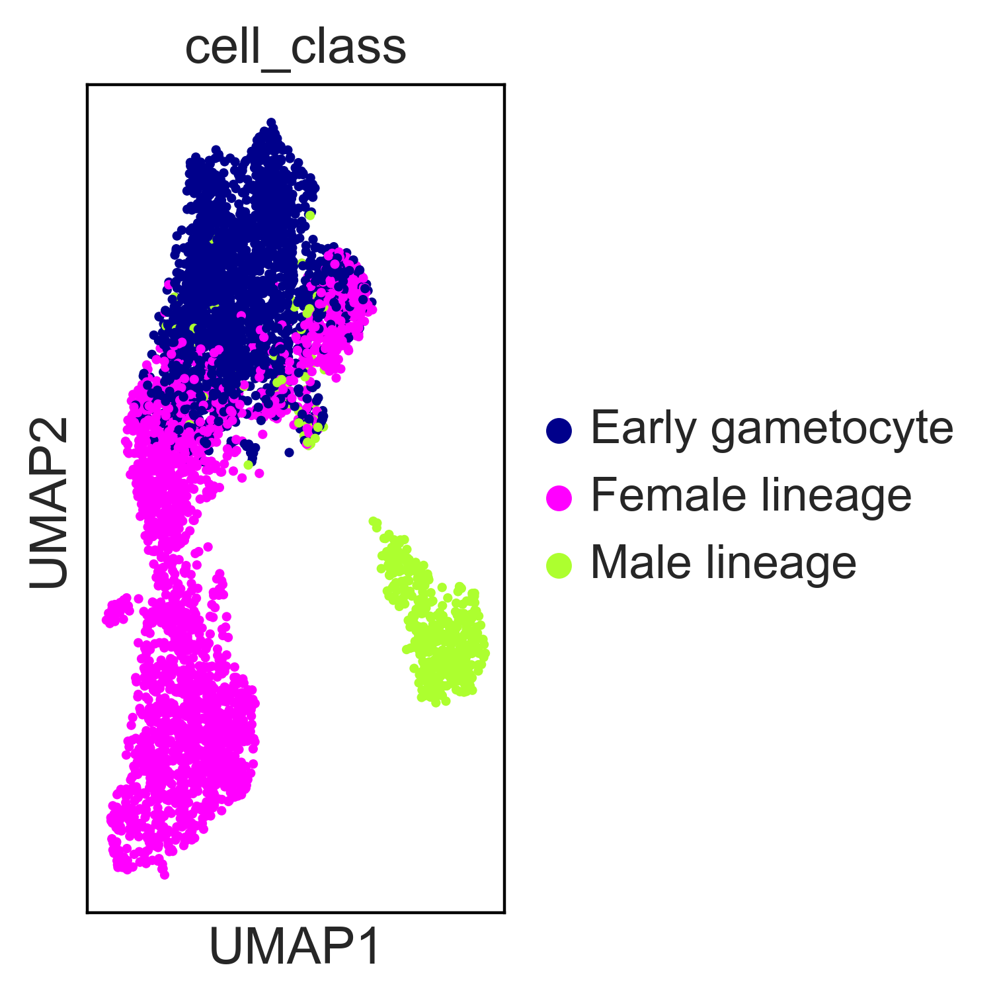

In [69]:
sc.pl.umap(ad_vis, color=['cell_class'])

In [102]:
color_class = dict(zip(adata.obs.cell_class.dtype.categories, adata.uns['cell_class_colors']))
color_clusters = dict(zip(adata.obs.annotation.dtype.categories, adata.uns['annotation_colors']))

In [269]:
color_clusters

{'0': '#1f77b4',
 '1': '#ff7f0e',
 '2': '#279e68',
 '3': '#d62728',
 '4': '#aa40fc',
 '5': '#8c564b',
 '6': '#e377c2',
 '7': '#b5bd61',
 '8': '#17becf',
 '9': '#aec7e8'}

In [104]:
#auc_mtx_v1 = pd.read_csv('auc_mtx_v1.csv', index_col=0)

In [256]:
#df_metadata = pd.read_csv(CELL_ANNOTATIONS_FNAME, sep = ';')
df_metadata = pd.read_csv('./data_new/cells_metadata.csv')

In [140]:
df_metadata = adata.obs
#df_metadata.index.name = "Barcode"

In [142]:
#df_metadata.to_csv('./data_new/cells_metadata.csv')

In [270]:
df_metadata

,Barcode,n_genes,umi_counts,louvain_1.0,louvain_0.6,louvain_0.4,louvain_1.4,clusters,S_score,G2M_score,...,annotation,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,total_counts_ribo,pct_counts_ribo,total_counts_hb,pct_counts_hb,imcs_score
0,AAACCCAAGATGAATC-1,1340,2798.60820,0,0,0,7,0,-0.175439,-0.175439,...,C0,1340,2798.60820,0.0,0.0,0.0,0.0,0.0,0.0,0.088206
1,AAACCCAGTGAATAAC-1,1524,2994.50590,5,5,5,11,5,0.047093,0.047093,...,C5,1524,2994.50590,0.0,0.0,0.0,0.0,0.0,0.0,-0.228579
2,AAACCCAGTGAATTAG-1,1298,2745.15400,5,5,5,11,5,-0.022611,-0.022611,...,C5,1298,2745.15400,0.0,0.0,0.0,0.0,0.0,0.0,0.115212
3,AAACCCATCCATCTAT-1,241,893.01843,8,1,1,10,8,-0.067437,-0.067437,...,C8,241,893.01843,0.0,0.0,0.0,0.0,0.0,0.0,-0.001631
4,AAACGAAAGGCGTCCT-1,1192,2590.70560,5,5,5,6,5,-0.199007,-0.199007,...,C5,1192,2590.70560,0.0,0.0,0.0,0.0,0.0,0.0,-0.064071
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4550,TTTGTTGGTAAGGCTG-1,1305,2757.71140,5,5,5,11,5,-0.119880,-0.119880,...,C5,1305,2757.71140,0.0,0.0,0.0,0.0,0.0,0.0,0.059067
4551,TTTGTTGGTCGGTGTC-1,808,2063.05400,0,0,0,2,0,-0.045277,-0.045277,...,C0,808,2063.05400,0.0,0.0,0.0,0.0,0.0,0.0,0.041830
4552,TTTGTTGGTCGTGGTC-1,686,1850.38290,6,3,3,5,6,-0.048457,-0.048457,...,C6,686,1850.38290,0.0,0.0,0.0,0.0,0.0,0.0,0.078010
4553,TTTGTTGGTGAGTTGG-1,1728,3202.45100,5,5,5,11,5,-0.009218,-0.009218,...,C5,1728,3202.45100,0.0,0.0,0.0,0.0,0.0,0.0,0.097129


In [96]:
cell_type_color_lut = dict(zip(adata.obs.cell_class.dtype.categories, COLORS))
cell_type_color_lut = dict(zip(adata.obs.cell_class.dtype.categories, adata.uns['cell_class_colors']))
#cell_id2cell_type_lut = df_metadata.set_index('Barcode').cell_class.to_dict()
bw_palette = sns.xkcd_palette(["white", "black"])

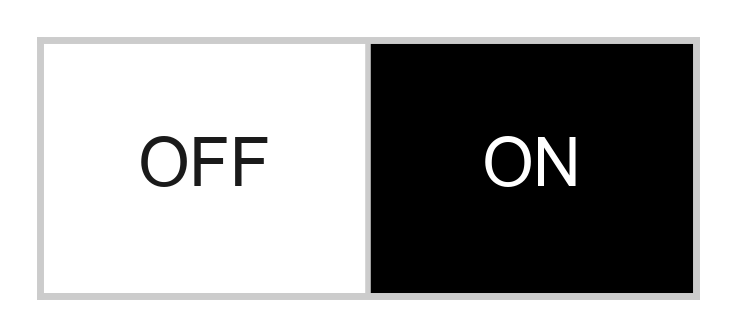

In [97]:
sns.set()
sns.set_style("whitegrid")
fig = palplot(bw_palette, ['OFF', 'ON'], ['k', 'w'])

In [103]:
sns.set()
sns.set(font_scale=0.8)
fig = palplot(sns.color_palette(COLORS), adata.obs.cell_class.dtype.categories, size=2)

NameError: name 'COLORS' is not defined

/Users/mubashermohammed/miniconda3/envs/cellrank/lib/python3.8/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


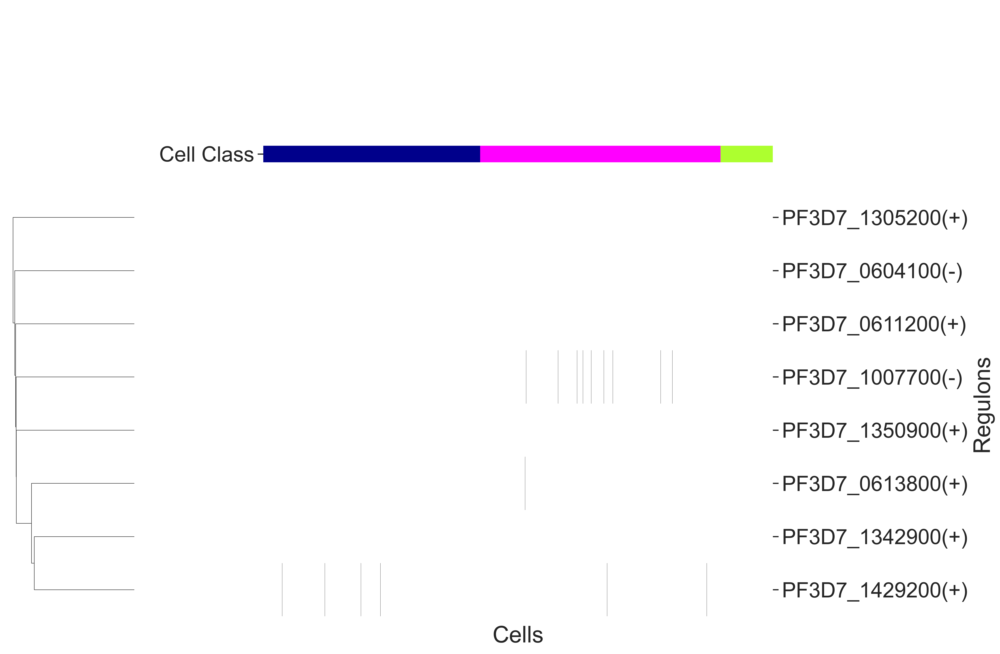

In [285]:
sns.set()
sns.set(font_scale=2.0)
sns.set_style("ticks", {"xtick.minor.size": 1, "ytick.minor.size": 0.1})
g = sns.clustermap(auc_mtx_Z.T, method="single", col_cluster=False, row_cluster=True,
               col_colors=auc_mtx.index.map(cell_id2cell_type_lut).map(cell_type_color_lut),
               cmap=bw_palette, figsize=(15,10))
g.ax_heatmap.set_xticklabels([])
g.ax_heatmap.set_xticks([])
g.ax_heatmap.set_xlabel('Cells')
g.ax_heatmap.set_ylabel('Regulons')
g.ax_col_colors.set_yticks([0.5])
g.ax_col_colors.set_yticklabels(['Cell Class'])
g.cax.set_visible(False)
#g.fig.savefig('clustermap - Regulons_V1.png', format='png')

/Users/mubashermohammed/miniconda3/envs/cellrank/lib/python3.8/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


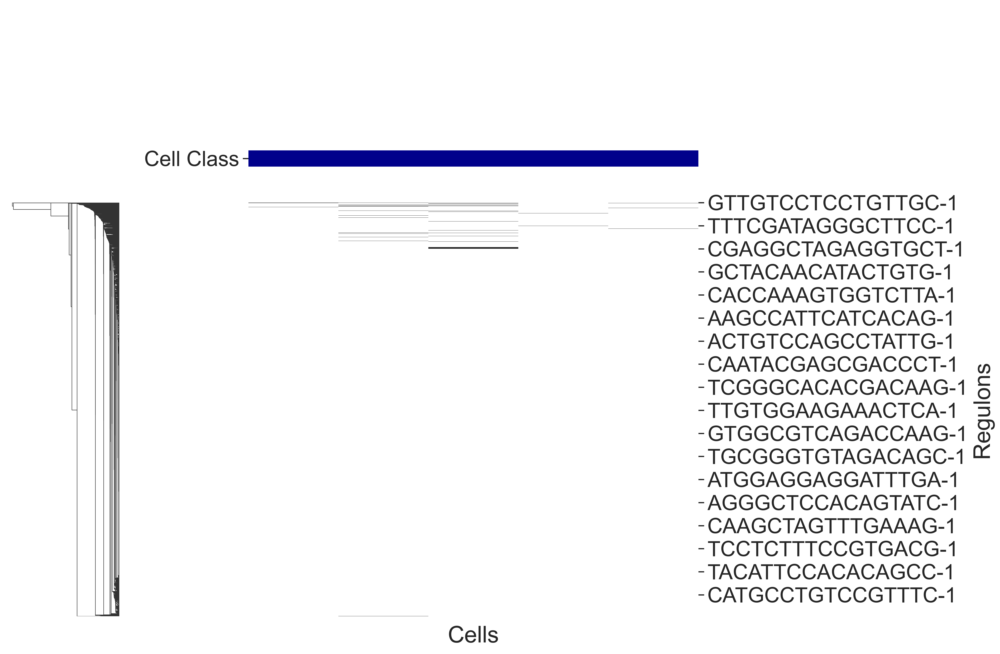

In [185]:
sns.set()
sns.set(font_scale=2.0)
sns.set_style("ticks", {"xtick.minor.size": 1, "ytick.minor.size": 0.1})
g = sns.clustermap(bin_mtx.T, method="single", col_cluster=False, row_cluster=True,
               col_colors=auc_mtx.index.map(cell_id2cell_type_lut).map(cell_type_color_lut),
               cmap=bw_palette, figsize=(15,10))
g.ax_heatmap.set_xticklabels([])
g.ax_heatmap.set_xticks([])
g.ax_heatmap.set_xlabel('Cells')
g.ax_heatmap.set_ylabel('Regulons')
g.ax_col_colors.set_yticks([0.5])
g.ax_col_colors.set_yticklabels(['Cell Class'])
g.cax.set_visible(False)
#g.fig.savefig('clustermap - Regulons_V2.png', format='png')

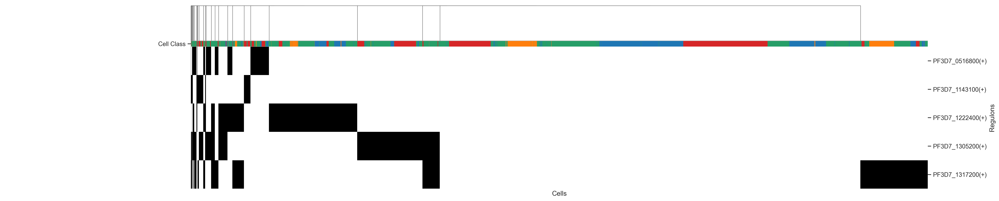

In [47]:
sns.set()
sns.set(font_scale=1.0)
sns.set_style("ticks", {"xtick.minor.size": 1, "ytick.minor.size": 0.1})
g = sns.clustermap(binary_mtx.T, method="single", col_cluster=True, row_cluster=False, 
               col_colors=auc_mtx.index.map(cell_id2cell_type_lut).map(cell_type_color_lut),
               cmap=bw_palette, figsize=(25,7))
g.ax_heatmap.set_xticklabels([])
g.ax_heatmap.set_xticks([])
g.ax_heatmap.set_xlabel('Cells')
g.ax_heatmap.set_ylabel('Regulons')
g.ax_col_colors.set_yticks([0.5])
g.ax_col_colors.set_yticklabels(['Cell Class'])
g.cax.set_visible(False)
#g.fig.savefig('clustermap - Regulons_V2.png', format='png')

In [275]:
rss_cellType = regulon_specificity_scores(auc_mtx, adata.obs.cell_class)
rss_cellType

,PF3D7_0604100(-),PF3D7_0611200(+),PF3D7_0613800(+),PF3D7_1007700(-),PF3D7_1305200(+),PF3D7_1342900(+),PF3D7_1350900(+),PF3D7_1429200(+)
Early gametocyte,0.223661,0.256256,0.258462,0.214958,0.274475,0.379790,0.250522,0.232212
Male lineage,0.191876,0.210140,0.215994,0.185910,0.216497,0.245515,0.206104,0.199386
Female lineage,0.217928,0.262440,0.268508,0.213435,0.278085,0.390621,0.248586,0.234750


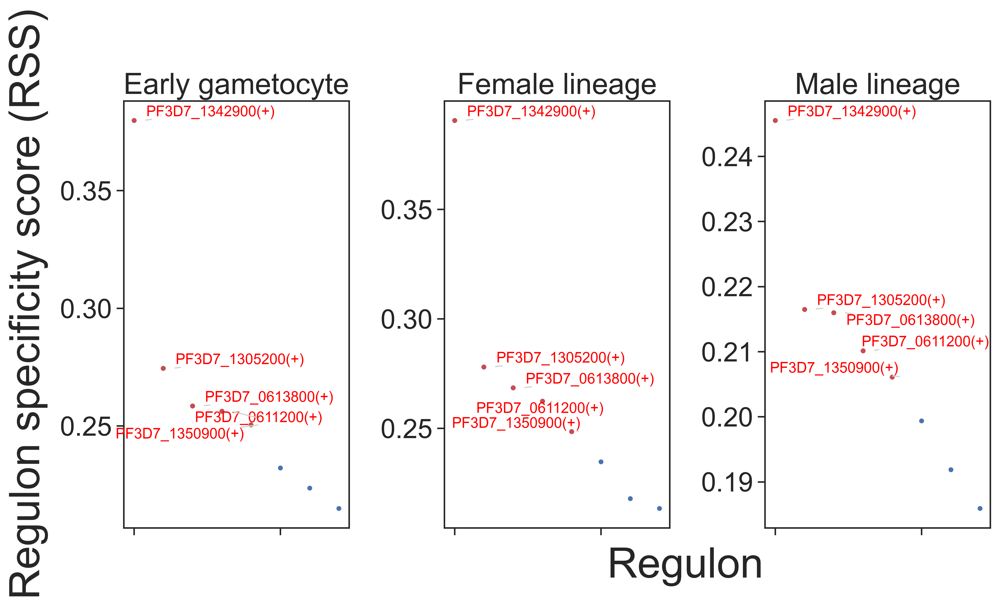

In [276]:
cats = sorted(list(set(adata.obs.cell_class)))

fig = plt.figure(figsize=(15, 6))
for c,num in zip(cats, range(1,len(cats)+1)):
    x=rss_cellType.T[c]
    ax = fig.add_subplot(1,4,num)
    plot_rss(rss_cellType, c, top_n=5, max_n=None, ax=ax)
    ax.set_ylim( x.min()-(x.max()-x.min())*0.05 , x.max()+(x.max()-x.min())*0.05 )
    for t in ax.texts:
        t.set_fontsize(12)
    ax.set_ylabel('')
    ax.set_xlabel('')
    adjust_text(ax.texts, autoalign='xy', ha='right', va='bottom', arrowprops=dict(arrowstyle='-',color='lightgrey'), precision=0.001 )
 
fig.text(0.5, 0.0, 'Regulon', ha='center', va='center', size='x-large')
fig.text(0.00, 0.5, 'Regulon specificity score (RSS)', ha='center', va='center', rotation='vertical', size='x-large')
plt.tight_layout()
plt.rcParams.update({
    'figure.autolayout': True,
        'figure.titlesize': 'large' ,
        'axes.labelsize': 'medium',
        'axes.titlesize':'large',
        'xtick.labelsize':'medium',
        'ytick.labelsize':'medium'
        })
#fig.savefig("RSS_score.png")

In [277]:
topreg = []
for i,c in enumerate(cats):
    topreg.extend(
        list(rss_cellType.T[c].sort_values(ascending=False)[:5].index)
    )
topreg = list(set(topreg))

In [278]:
topreg

['PF3D7_1350900(+)',
 'PF3D7_0613800(+)',
 'PF3D7_0611200(+)',
 'PF3D7_1342900(+)',
 'PF3D7_1305200(+)']

In [279]:
auc_mtx_Z = pd.DataFrame( index=auc_mtx.index )
for col in list(auc_mtx.columns):
    auc_mtx_Z[ col ] = ( auc_mtx[col] - auc_mtx[col].mean()) / auc_mtx[col].std(ddof=0)
#auc_mtx_Z.sort_index(inplace=True)

In [280]:
def palplot(pal, names, colors=None, size=1):
    n = len(pal)
    f, ax = plt.subplots(1, 1, figsize=(n * size, size))
    ax.imshow(np.arange(n).reshape(1, n),
              cmap=mpl.colors.ListedColormap(list(pal)),
              interpolation="nearest", aspect="auto")
    ax.set_xticks(np.arange(n) - .5)
    ax.set_yticks([-.5, .5])
    ax.set_xticklabels([])
    ax.set_yticklabels([])
    colors = n * ['k'] if colors is None else colors
    for idx, (name, color) in enumerate(zip(names, colors)):
        ax.text(0.0+idx, 0.0, name, color=color, horizontalalignment='center', verticalalignment='center')
    return f

In [281]:
#cell_type_color_lut = dict(zip(adata.obs.cell_class.dtype.categories, COLORS))
cell_type_color_lut = dict(zip(adata.obs.cell_class.dtype.categories, adata.uns['cell_class_colors']))
cell_id2cell_type_lut = df_metadata.set_index('Barcode').cell_class.to_dict()
bw_palette = sns.xkcd_palette(["white", "black"])

In [117]:
sns.set()
sns.set(font_scale=0.8)
fig = palplot(sns.color_palette(COLORS), adata.obs.cell_class.dtype.categories, size=2)

NameError: name 'COLORS' is not defined

In [202]:
sns.set(font_scale=1.2)
g = sns.clustermap(auc_mtx_Z[topreg], annot=False,  square=False,  linecolor='gray',
    yticklabels=False, xticklabels=True, vmin=-2, vmax=6, row_colors=auc_mtx.index.map(cell_id2cell_type_lut).map(cell_type_color_lut),
    cmap="YlGnBu", figsize=(21,16) )
g.cax.set_visible(True)
g.ax_heatmap.set_ylabel('')
g.ax_heatmap.set_xlabel('')
#plt.savefig("PBMC10k_cellType-heatmap-top5.pdf", dpi=600, bbox_inches = "tight")

/Users/testi/miniconda3/envs/cellrank/lib/python3.8/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


Text(0.5, 32.08888888888842, '')

In [186]:
binary_mtx, auc_thresholds = binarize( auc_mtx, num_workers=25 )
binary_mtx.head()

,PF3D7_0604100(-),PF3D7_0611200(+),PF3D7_0613800(+),PF3D7_1007700(-),PF3D7_1305200(+),PF3D7_1342900(+),PF3D7_1350900(+),PF3D7_1429200(+)
AAACCCAAGATGAATC-1,0,0,0,0,0,0,0,0
TATTCCACAGGTTACT-1,0,0,0,0,0,0,0,0
TATTCCAAGCGATTCT-1,0,1,0,0,0,1,0,0
TATGTTCTCCAGCTCT-1,0,0,1,0,0,0,0,0
TATGTTCGTGTCCACG-1,0,0,0,0,0,0,0,0


/var/folders/h5/cwp4w7cd35554f006psf_z9w0000gn/T/ipykernel_5354/3246400053.py:5: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(auc_mtx[ r[i] ], ax=ax, norm_hist=True, bins=100)
/var/folders/h5/cwp4w7cd35554f006psf_z9w0000gn/T/ipykernel_5354/3246400053.py:5: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.d

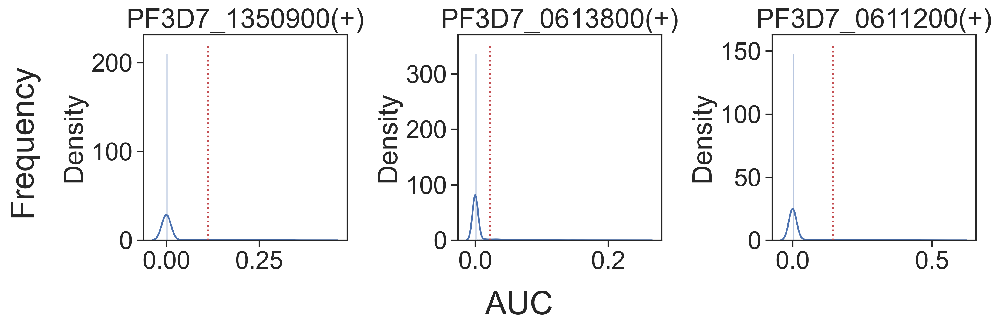

In [188]:
r = [ 'PF3D7_1350900(+)', 'PF3D7_0613800(+)', 'PF3D7_0611200(+)' ]

fig, axs = plt.subplots(1, 3, figsize=(12, 4), dpi=150, sharey=False)
for i,ax in enumerate(axs):
    sns.distplot(auc_mtx[ r[i] ], ax=ax, norm_hist=True, bins=100)
    ax.plot( [ auc_thresholds[ r[i] ] ]*2, ax.get_ylim(), 'r:')
    ax.title.set_text( r[i] )
    ax.set_xlabel('')
    
fig.text(-0.01, 0.5, 'Frequency', ha='center', va='center', rotation='vertical', size='large')
fig.text(0.5, -0.01, 'AUC', ha='center', va='center', rotation='horizontal', size='large')

fig.tight_layout()
#fig.savefig('PBMC10k_cellType-binaryPlot2.pdf', dpi=600, bbox_inches='tight')

In [261]:
adjacencies = pd.read_csv("grn_adj_new.csv", index_col=False)

In [260]:
from pyscenic.utils import modules_from_adjacencies


In [262]:
regulons = {}
for i,r in pd.DataFrame(lf.ra.Regulons,index=lf.ra.Gene).iteritems():
    regulons[i] =  list(r[r==1].index.values)

In [263]:
regulons

{'PF3D7_0604100(-)': ['PF3D7_0604100'],
 'PF3D7_0611200(+)': ['PF3D7_0903700', 'PF3D7_0204900'],
 'PF3D7_0613800(+)': ['PF3D7_1420700',
  'PF3D7_1474000',
  'PF3D7_1355700',
  'PF3D7_1236200',
  'PF3D7_1138400',
  'PF3D7_0420300',
  'PF3D7_0314700'],
 'PF3D7_1007700(-)': ['PF3D7_1466500', 'PF3D7_1310700', 'PF3D7_0306200'],
 'PF3D7_1305200(+)': ['PF3D7_0727600', 'PF3D7_0219100'],
 'PF3D7_1342900(+)': ['PF3D7_1407800',
  'PF3D7_1408100',
  'PF3D7_1420700',
  'PF3D7_1429200',
  'PF3D7_1433700',
  'PF3D7_1442600',
  'PF3D7_1444100',
  'PF3D7_1473700',
  'PF3D7_1474000',
  'PF3D7_1476500',
  'PF3D7_1333200',
  'PF3D7_1229100',
  'PF3D7_1122900',
  'PF3D7_1126000',
  'PF3D7_1131400',
  'PF3D7_1147300',
  'PF3D7_0914500',
  'PF3D7_0817300',
  'PF3D7_0314700'],
 'PF3D7_1350900(+)': ['PF3D7_1121600', 'PF3D7_0810800', 'PF3D7_0314700'],
 'PF3D7_1429200(+)': ['PF3D7_1420700',
  'PF3D7_1429200',
  'PF3D7_1444100',
  'PF3D7_1236200',
  'PF3D7_0314700']}

In [264]:
exprMat = pd.DataFrame( lf[:,:], index=lf.ra.Gene, columns=lf.ca.CellID).T

In [265]:
modules = list(modules_from_adjacencies(adjacencies, exprMat))


2023-02-03 09:34:33,288 - pyscenic.utils - INFO - Calculating Pearson correlations.

2023-02-03 09:34:33,314 - pyscenic.utils - WARNING - Note on correlation calculation: the default behaviour for calculating the correlations has changed after pySCENIC verion 0.9.16. Previously, the default was to calculate the correlation between a TF and target gene using only cells with non-zero expression values (mask_dropouts=True). The current default is now to use all cells to match the behavior of the R verision of SCENIC. The original settings can be retained by setting 'rho_mask_dropouts=True' in the modules_from_adjacencies function, or '--mask_dropouts' from the CLI.
	Dropout masking is currently set to [False].

2023-02-03 09:34:35,602 - pyscenic.utils - INFO - Creating modules.


In [ ]:
'PF3D7_0604100', 'PF3D7_0611200', 'PF3D7_0613800', 'PF3D7_1007700', 'PF3D7_1305200', 'PF3D7_1342900', 'PF3D7_1350900', 'PF3D7_1429200'

In [274]:
tf = 'PF3D7_0613800'
tf_mods = [ x for x in modules if x.transcription_factor==tf ]

for i,mod in enumerate( tf_mods ):
    print( f'{tf} module {str(i)}: {len(mod.genes)} genes' )
print( f'{tf} regulon: {len(regulons[tf+"(+)"])} genes' )

PF3D7_0613800 module 0: 924 genes
PF3D7_0613800 module 1: 621 genes
PF3D7_0613800 module 2: 51 genes
PF3D7_0613800 module 3: 1404 genes
PF3D7_0613800 module 4: 1585 genes
PF3D7_0613800 module 5: 1601 genes
PF3D7_0613800 regulon: 7 genes


In [276]:
for i,mod in enumerate( tf_mods ):
    with open( tf+'_module_'+str(i)+'.txt', 'w') as f:
        for item in mod.genes:
            f.write("%s\n" % item)
            
with open( tf+'_regulon.txt', 'w') as f:
    for item in regulons[tf+'(+)']:
        f.write("%s\n" % item)

In [283]:
with open("TFs2targets.txt", "w") as output:
    output.write(str(regulons))

In [285]:
regulons = [r.rename(r.name.replace('(+)',' ('+str(len(r))+'g)')) for r in regulons]
regulons

AttributeError: 'str' object has no attribute 'rename'

In [286]:
export2loom(ad.to_df(), regulons, LOOM_FNAME,
            cell_annotations=ad.obs['cell_class'].to_dict(),
            auc_mtx = auc_mtx,
            tree_structure=(),
            nomenclature="Single_cell-gametocyte", auc_thresholds=thresholds,
            compress=False)

KeyError: 0

In [281]:
thresholds

PF3D7_0604100(-)    0.196560
PF3D7_0611200(+)    0.145083
PF3D7_0613800(+)    0.022346
PF3D7_1007700(-)    0.049519
PF3D7_1305200(+)    0.153942
PF3D7_1342900(+)    0.037944
PF3D7_1350900(+)    0.112827
PF3D7_1429200(+)    0.037651
dtype: float64

In [52]:
with open("TFs2targets.txt", "w") as output:
    output.write(str(regulons))

In [55]:
adata.write_h5ad(ANNDATA_FNAME_out)

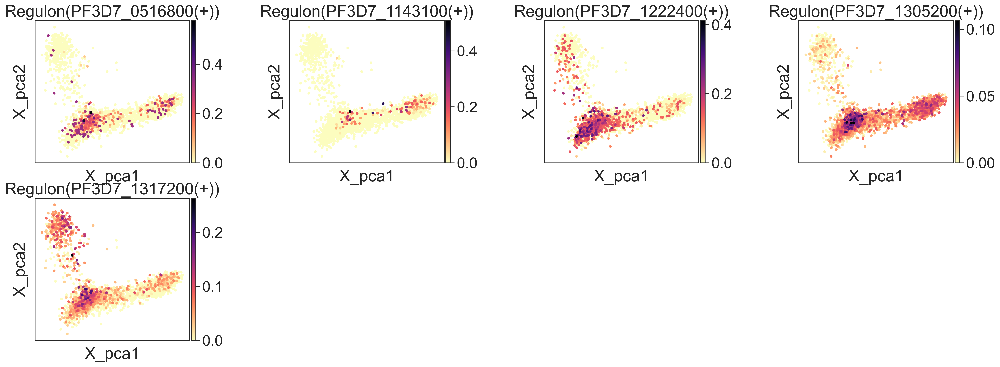

In [218]:
regs = ["Regulon(PF3D7_0516800(+))","Regulon(PF3D7_1143100(+))","Regulon(PF3D7_1222400(+))","Regulon(PF3D7_1305200(+))", "Regulon(PF3D7_1317200(+))"]
sc.pl.embedding(ad,"X_pca",color=regs, cmap='magma_r', size = 60, wspace=0.5) #save='regs_umap.png',

/Users/testi/miniconda3/envs/cellrank/lib/python3.8/site-packages/scanpy/plotting/_utils.py:288: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  pl.savefig(filename, dpi=dpi, bbox_inches='tight')
/Users/testi/miniconda3/envs/cellrank/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.canvas.print_figure(bytes_io, **kw)


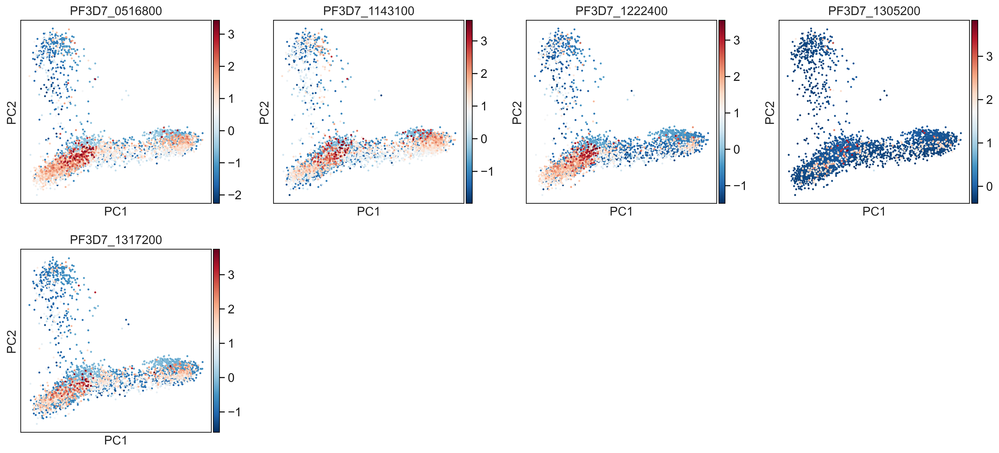

In [70]:
TFs =['PF3D7_0516800', 'PF3D7_1143100', 'PF3D7_1222400', 'PF3D7_1305200', 'PF3D7_1317200']
sc.pl.pca(ad_vis, color= TFs , cmap='RdBu_r', size =20, save = 'umapsTFs_umpas.png')

In [45]:
regulons = [r.rename(r.name.replace('(',' (')) for r in regulons]

In [318]:
export2loom(adata.to_df(), regulons, LOOM_FNAME,
            cell_annotations=adata.obs['cell_class'].to_dict(),
            auc_mtx = auc_mtx,
            tree_structure=(),
            nomenclature="Single_cell-gametocyte", auc_thresholds=thresholds,
            compress=False)

In [139]:
#TF to target genes expression profiles
TF_PF3D7_1305200 = [x.strip() for x in open('TF_PF3D7_1305200_tgenes.txt')]
TF_PF3D7_0516800 = [x.strip() for x in open('TF_PF3D7_0516800_tgenes.txt')]
TF_PF3D7_1222400 = [x.strip() for x in open('TF_PF3D7_1222400_tgenes.txt')]
TF_PF3D7_1143100 = [x.strip() for x in open('TF_PF3D7_1143100_tgenes.txt')]
TF_PF3D7_1317200 = [x.strip() for x in open('TF_PF3D7_1317200_tgenes.txt')]

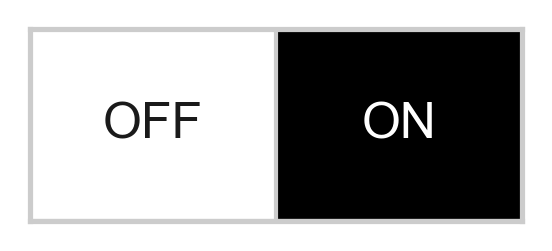

In [194]:
sns.set()
sns.set_style("whitegrid")
fig = palplot(bw_palette, ['OFF', 'ON'], ['k', 'w'])
fig.savefig('Legend.png', format='png')

In [99]:
sns.set()
sns.set(font_scale=0.8)
fig = palplot(sns.color_palette(COLORS), adata.obs.annotation.dtype.categories, size=1)
fig.savefig('clusters-legend.png', format='png')

NameError: name 'COLORS' is not defined

In [43]:
#get the thershold and the bin
auc_mtx_unsorted = auc_mtx
auc_mtx_unsorted['annotation']=adata.obs['annotation']
auc_mtx_unsorted.sort_values(by='annotation', inplace=True)
auc_mtx=auc_mtx_unsorted.drop('annotation', axis=1)
binary_mtx, thresholds = binarize(auc_mtx)

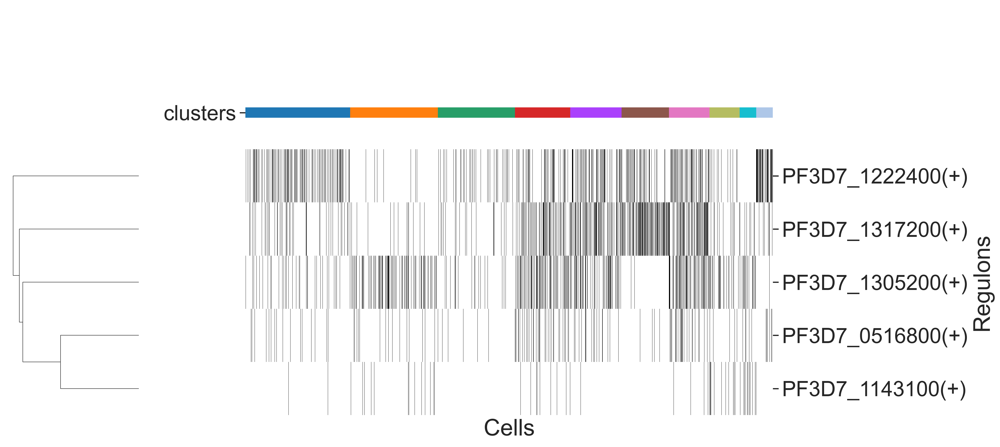

In [180]:
sns.set()
sns.set(font_scale=2.0)
sns.set_style("ticks", {"xtick.minor.size": 1, "ytick.minor.size": 0.1})
g = sns.clustermap(binary_mtx.T, method="single", col_cluster=False, row_cluster=True,
               col_colors=auc_mtx.index.map(cell_id2cell_type_lut).map(cell_type_color_lut),
               cmap=bw_palette, figsize=(15,7))
g.ax_heatmap.set_xticklabels([])
g.ax_heatmap.set_xticks([])
g.ax_heatmap.set_xlabel('Cells')
g.ax_heatmap.set_ylabel('Regulons')
g.ax_col_colors.set_yticks([0.5])
g.ax_col_colors.set_yticklabels(['clusters'])
g.cax.set_visible(False)
g.fig.savefig('clustermap_clusters annot- Regulons_V1.png', format='png')

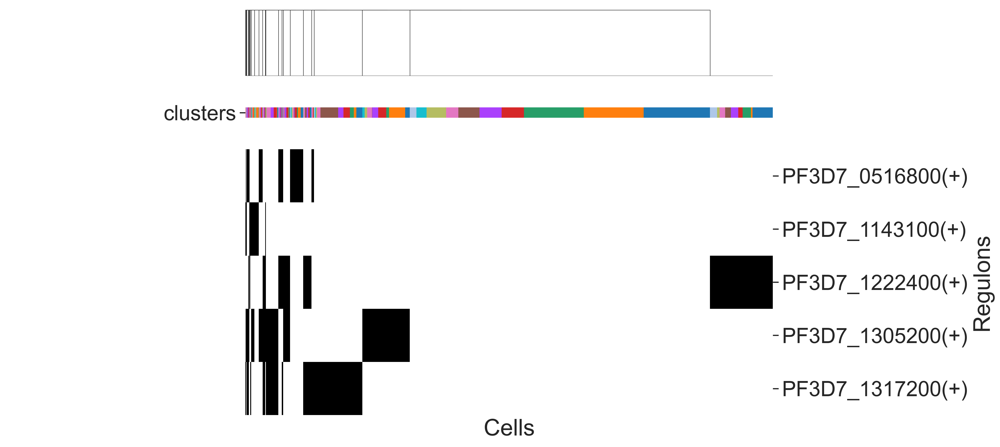

In [193]:
sns.set()
sns.set(font_scale=2.0)
sns.set_style("ticks", {"xtick.minor.size": 1, "ytick.minor.size": 0.1})
g = sns.clustermap(binary_mtx.T, method="single", col_cluster=True, row_cluster=False,
               col_colors=auc_mtx.index.map(cell_id2cell_type_lut).map(cell_type_color_lut),
               cmap=bw_palette, figsize=(15,7))
g.ax_heatmap.set_xticklabels([])
g.ax_heatmap.set_xticks([])
g.ax_heatmap.set_xlabel('Cells')
g.ax_heatmap.set_ylabel('Regulons')
g.ax_col_colors.set_yticks([0.5])
g.ax_col_colors.set_yticklabels(['clusters'])
g.cax.set_visible(False)
g.fig.savefig('clustermap_clusters annot- Regulons.png', format='png')

/Users/testi/miniconda3/envs/cellrank/lib/python3.8/site-packages/IPython/core/pylabtools.py:151: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.canvas.print_figure(bytes_io, **kw)


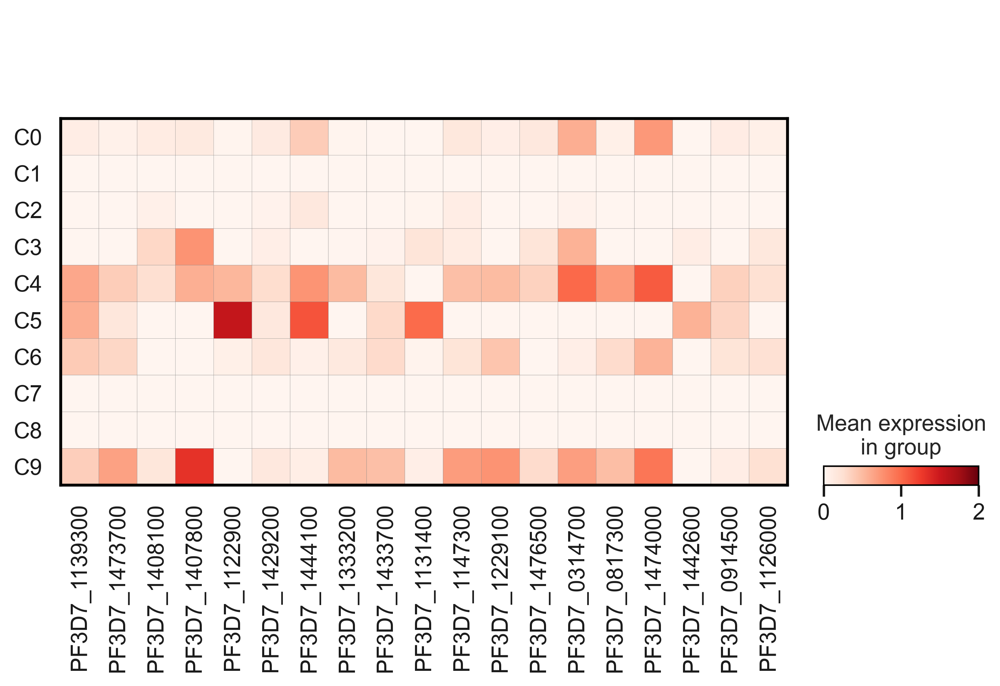

In [78]:
AP2G5_TARGET = ['PF3D7_1139300', 'PF3D7_1473700', 'PF3D7_1408100', 'PF3D7_1407800', 'PF3D7_1122900', 'PF3D7_1429200', 'PF3D7_1444100', 
               'PF3D7_1333200', 'PF3D7_1433700', 'PF3D7_1131400', 'PF3D7_1147300', 'PF3D7_1229100', 'PF3D7_1476500', 
               'PF3D7_0314700', 'PF3D7_0817300', 'PF3D7_1474000', 'PF3D7_1442600', 'PF3D7_0914500', 'PF3D7_1126000']
sc.pl.matrixplot(ad_vis, AP2G5_TARGET, groupby='annotation', swap_axes=False, cmap='Reds', vmin=0, vmax=2)

In [48]:
df_metadata = pd.read_csv('updated_metadata.csv', index_col=0)
df_metadata

,n_genes,umi_counts,louvain_1.0,louvain_0.6,louvain_0.4,louvain_1.4,clusters,S_score,G2M_score,phase,...,Regulon.PF3D7_1107800....,Regulon.PF3D7_1139300....,Regulon.PF3D7_1139300.....1,Regulon.PF3D7_1222400....,Regulon.PF3D7_1239200....,Regulon.PF3D7_1350900....,Regulon.PF3D7_1408200....,pruned_labels,bulk_labels,first_labels
AAACCCAAGATGAATC-1,1340,2798.60820,0,0,0,7,0,-0.175439,-0.175439,G1,...,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,II.Day5,II.Day5,II.Day5
AAACCCAGTGAATAAC-1,1524,2994.50590,5,5,5,11,5,0.047093,0.047093,S,...,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,II.III.Day6,II.III.Day6,II.III.Day6
AAACCCAGTGAATTAG-1,1298,2745.15400,5,5,5,11,5,-0.022611,-0.022611,G1,...,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,II.III.Day6,II.III.Day6,II.III.Day6
AAACCCATCCATCTAT-1,241,893.01843,8,1,1,10,8,-0.067437,-0.067437,G1,...,0.161355,0.000000,0.0,0.161355,0.000000,0.000000,0.111554,IV.Day8,IV.Day8,IV.Day8
AAACGAAAGGCGTCCT-1,1192,2590.70560,5,5,5,6,5,-0.199007,-0.199007,G1,...,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,II.III.Day6,II.III.Day6,II.III.Day6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGGTAAGGCTG-1,1305,2757.71140,5,5,5,11,5,-0.119880,-0.119880,G1,...,0.000000,0.005976,0.0,0.000000,0.486056,0.800797,0.000000,IV.Day8,IV.Day8,II.III.Day6
TTTGTTGGTCGGTGTC-1,808,2063.05400,0,0,0,2,0,-0.045277,-0.045277,G1,...,0.000000,0.027446,0.0,0.000000,0.000000,0.000000,0.000000,II.III.Day6,II.III.Day6,IV.Day8
TTTGTTGGTCGTGGTC-1,686,1850.38290,6,3,3,5,6,-0.048457,-0.048457,G1,...,0.000000,0.066622,0.0,0.000000,0.000000,0.000000,0.000000,IV.Day8,IV.Day8,IV.Day8
TTTGTTGGTGAGTTGG-1,1728,3202.45100,5,5,5,11,5,-0.009218,-0.009218,G1,...,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,II.III.Day6,II.III.Day6,II.III.Day6


In [191]:
ad = ad_vis

In [49]:
ad.obs = df_metadata

In [1]:
import seaborn as sns
import numpy as np
import pandas as pd
import scanpy as sc
#import palantir
#import harmony
#from pySankey import sankey
#import hvplot.pandas
import matplotlib.pyplot as plt
#from bioinfokit import analys, visuz
import matplotlib as mpl
from anndata import AnnData
from matplotlib import rcParams
#import pyclusterprofiler
#from pybiomart import Dataset

from scipy.sparse import issparse, isspmatrix_csr, isspmatrix_coo
from scipy.sparse import spmatrix, csr_matrix
from sklearn.utils.sparsefuncs import mean_variance_axis
sc.logging.print_header()
sc.settings.verbosity = 3

/Users/testi/miniconda3/envs/cellrank/lib/python3.8/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


scanpy==1.9.1 anndata==0.8.0 umap==0.5.3 numpy==1.22.4 scipy==1.10.0 pandas==1.5.3 scikit-learn==1.1.1 statsmodels==0.13.5 python-igraph==0.10.2 pynndescent==0.5.8


In [5]:
sc.settings.set_figure_params(dpi=200)

In [3]:
#ad.write_h5ad('scenic_out_for_vis_mohammedteal_muba_v2.h5ad')
ad = sc.read_h5ad ('scenic_out_for_vis_mohammedteal_muba_v2.h5ad')

/Users/testi/miniconda3/envs/cellrank/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


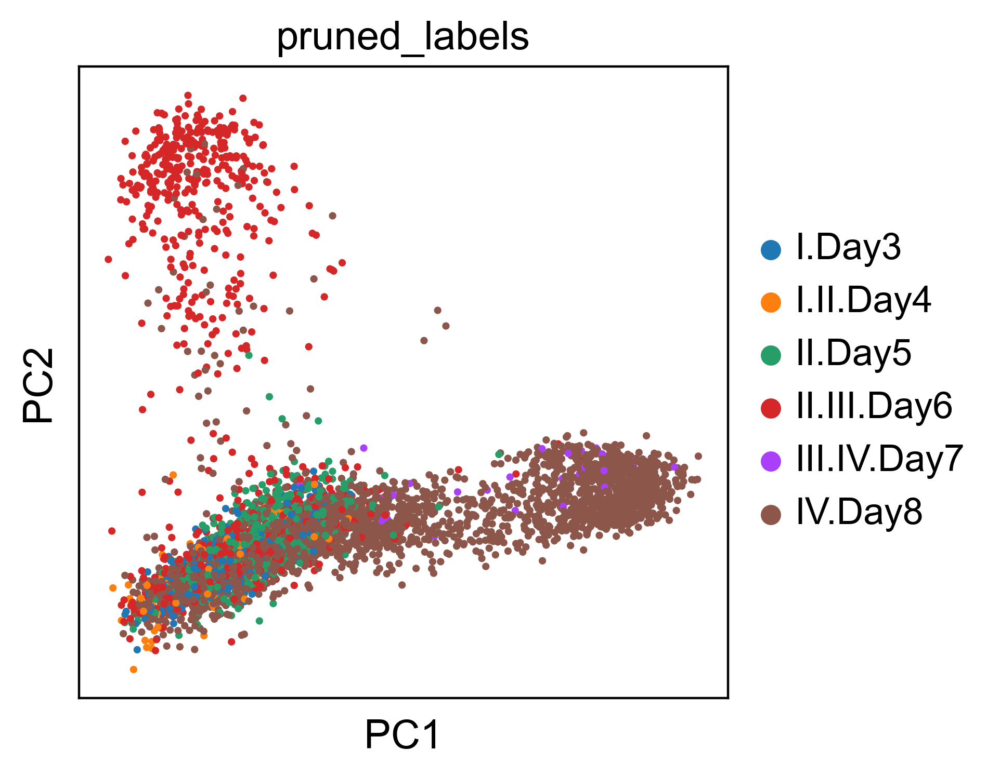

In [53]:
#ad.obs
sc.pl.pca(ad, color = ['pruned_labels'])

    using 'X_pca' with n_pcs = 300
Storing dendrogram info using `.uns['dendrogram_pruned_labels']`


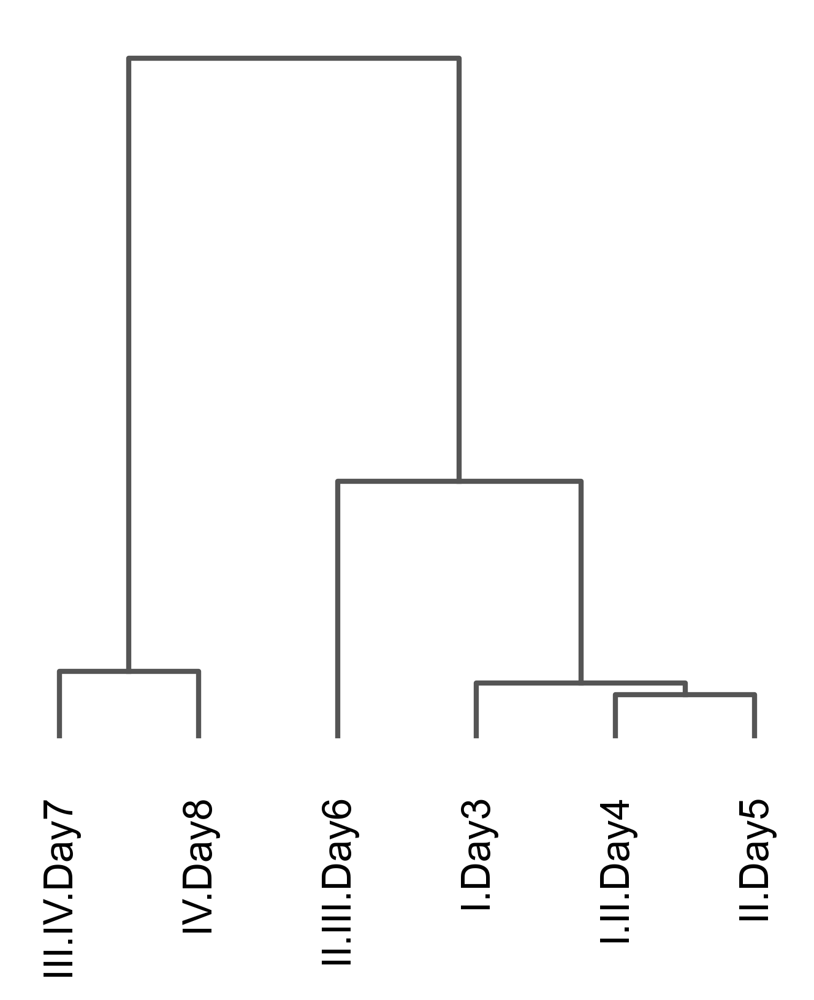

In [54]:
sc.tl.dendrogram(ad, 'pruned_labels')
ax = sc.pl.dendrogram(ad, 'pruned_labels')

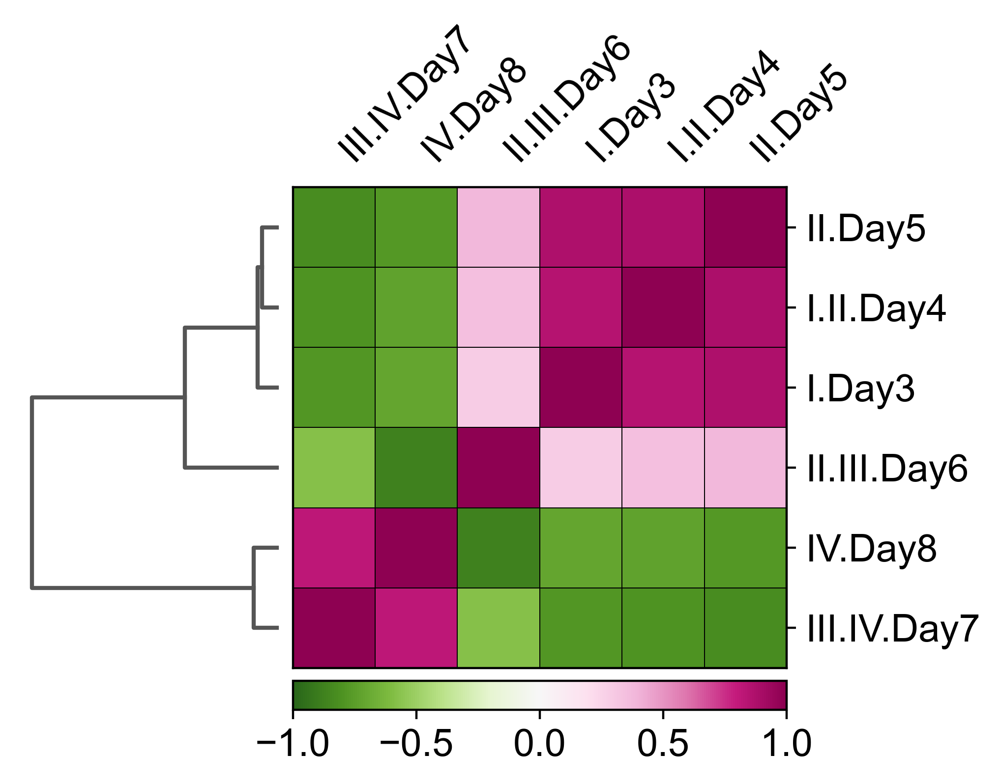

In [55]:
ax = sc.pl.correlation_matrix(ad, 'pruned_labels', cmap='PiYG_r', figsize=(5,3.5))

In [59]:
colorDict =  {'C0':'#1f77b4','C1':'#ff7f0e','C2':'#279e68',
              'C3':'#d62728','C4':'#aa40fc', 'C5':'#8c564b','C6':'#e377c2', 'C7':'#b5bd61','C8':'#17becf',
             'C9':'#aec7e8','Early gametocyte':'darkblue',
             'Female lineage':'magenta', 'Male lineage':'greenyellow'}

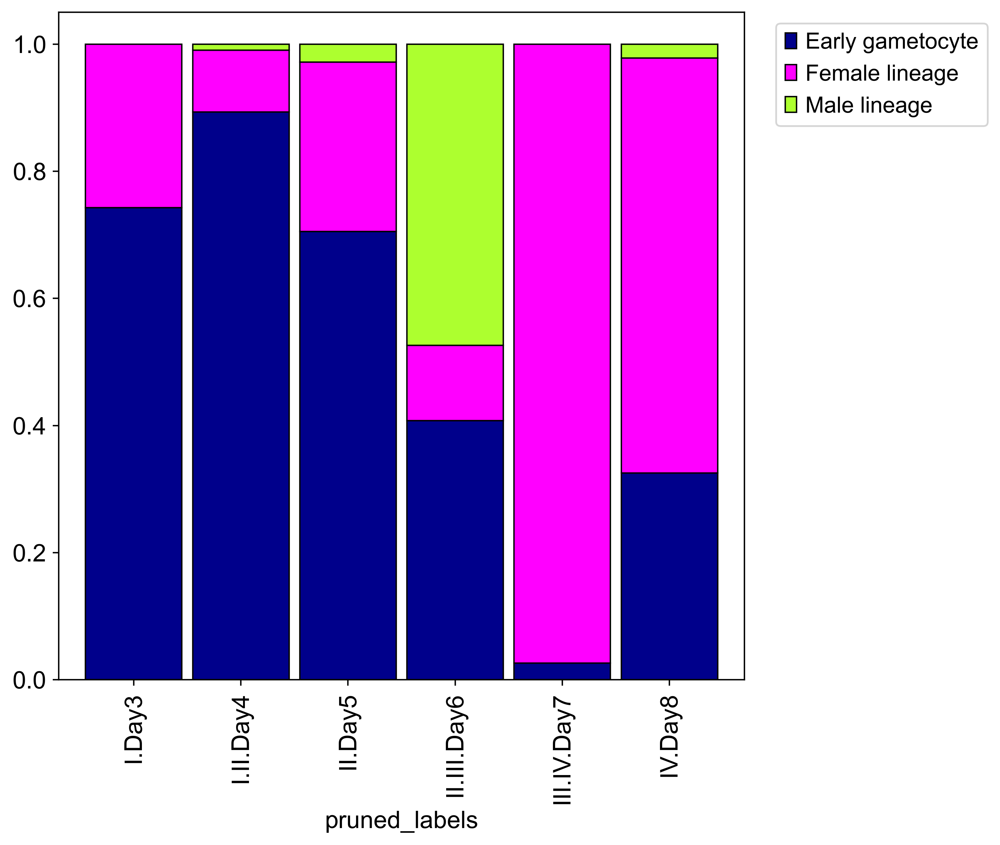

In [61]:
tmp = pd.crosstab(ad.obs['pruned_labels'],ad.obs['cell_class'], normalize='index')
ax = tmp.plot.bar(stacked=True, edgecolor='black', lw=0.8, figsize=(7,7), width=0.9, color=colorDict)



horiz_offset = 1.03
vert_offset = 1.
ax.grid(False)
ax.legend(bbox_to_anchor=(horiz_offset, vert_offset))
labels = ['Early gametocyte', 'Female lineage', 'Male lineage']
#ax.set_xticklabels(labels, rotation=30, ha="right",rotation_mode="anchor")

plt.savefig('./figures/cell_prop_class.png', dpi = 300)